# Temperature Forecast Project using ML

### Problem Statement

#### Data Set Information:

This data is for the purpose of bias correction of next-day maximum and minimum air temperatures forecast of the LDAPS model operated by the Korea Meteorological Administration over Seoul, South Korea. This data consists of summer data from 2013 to 2017. The input data is largely composed of the LDAPS model's next-day forecast data, in-situ maximum and minimum temperatures of present-day, and geographic auxiliary variables. There are two outputs (i.e. next-day maximum and minimum air temperatures) in this data. Hindcast validation was conducted for the period from 2015 to 2017.

#### Attribute Information:

For more information, read [Cho et al, 2020].
1. station - used weather station number: 1 to 25
2. Date - Present day: yyyy-mm-dd ('2013-06-30' to '2017-08-30')
3. Present_Tmax - Maximum air temperature between 0 and 21 h on the present day (Â°C): 20 to 37.6
4. Present_Tmin - Minimum air temperature between 0 and 21 h on the present day (Â°C): 11.3 to 29.9
5. LDAPS_RHmin - LDAPS model forecast of next-day minimum relative humidity (%): 19.8 to 98.5
6. LDAPS_RHmax - LDAPS model forecast of next-day maximum relative humidity (%): 58.9 to 100
7. LDAPS_Tmax_lapse - LDAPS model forecast of next-day maximum air temperature applied lapse rate (Â°C): 17.6 to 38.5
8. LDAPS_Tmin_lapse - LDAPS model forecast of next-day minimum air temperature applied lapse rate (Â°C): 14.3 to 29.6
9. LDAPS_WS - LDAPS model forecast of next-day average wind speed (m/s): 2.9 to 21.9
10. LDAPS_LH - LDAPS model forecast of next-day average latent heat flux (W/m2): -13.6 to 213.4
11. LDAPS_CC1 - LDAPS model forecast of next-day 1st 6-hour split average cloud cover (0-5 h) (%): 0 to 0.97
12. LDAPS_CC2 - LDAPS model forecast of next-day 2nd 6-hour split average cloud cover (6-11 h) (%): 0 to 0.97
13. LDAPS_CC3 - LDAPS model forecast of next-day 3rd 6-hour split average cloud cover (12-17 h) (%): 0 to 0.98
14. LDAPS_CC4 - LDAPS model forecast of next-day 4th 6-hour split average cloud cover (18-23 h) (%): 0 to 0.97
15. LDAPS_PPT1 - LDAPS model forecast of next-day 1st 6-hour split average precipitation (0-5 h) (%): 0 to 23.7
16. LDAPS_PPT2 - LDAPS model forecast of next-day 2nd 6-hour split average precipitation (6-11 h) (%): 0 to 21.6
17. LDAPS_PPT3 - LDAPS model forecast of next-day 3rd 6-hour split average precipitation (12-17 h) (%): 0 to 15.8
18. LDAPS_PPT4 - LDAPS model forecast of next-day 4th 6-hour split average precipitation (18-23 h) (%): 0 to 16.7
19. lat - Latitude (Â°): 37.456 to 37.645
20. lon - Longitude (Â°): 126.826 to 127.135
21. DEM - Elevation (m): 12.4 to 212.3
22. Slope - Slope (Â°): 0.1 to 5.2
23. Solar radiation - Daily incoming solar radiation (wh/m2): 4329.5 to 5992.9
24. Next_Tmax - The next-day maximum air temperature (Â°C): 17.4 to 38.9
25. Next_Tmin - The next-day minimum air temperature (Â°C): 11.3 to 29.8T

#### Please note that there are two target variables here: 

1) Next_Tmax: Next day maximum temperature

2) Next_Tmin: Next day  minimum temperature

## Importing necessary libraries

In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.utils import shuffle
%matplotlib inline
import warnings 
warnings.filterwarnings('ignore')

## Loading dataset

In [5]:
# loading csv file
df = pd.read_csv("temperature.csv")
pd.set_option("display.max_columns",None)
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,0.000000,0.000000,0.000000,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,0.159444,0.127727,0.000000,0.000000,0.000000,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,0.204091,0.142125,0.000000,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,0.161157,0.134249,0.000000,0.000000,0.000000,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,0.178892,0.170021,0.000000,0.000000,0.000000,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,30-08-2017,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,0.030034,0.081035,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,30-08-2017,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,0.035874,0.074962,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,30-08-2017,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,0.048954,0.059869,0.000000,0.000796,0.000000,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3


This dataset consists of summer data from 2013 to 2017.The dataset consists of continuous data. Here we have gor two target variables Next_Tmax and Next_Tmin.

## Exploratory Data Analysis(EDA)

In [6]:
# Checking the dimensions of dataset
df.shape

(7752, 25)

The dataset contains 7752 rows and 25 columns. Out of which two columns are target variables Next_Tmax and Next_Tmin.

In [7]:
# Checking the variables in the dataset
df.columns.tolist()

['station',
 'Date',
 'Present_Tmax',
 'Present_Tmin',
 'LDAPS_RHmin',
 'LDAPS_RHmax',
 'LDAPS_Tmax_lapse',
 'LDAPS_Tmin_lapse',
 'LDAPS_WS',
 'LDAPS_LH',
 'LDAPS_CC1',
 'LDAPS_CC2',
 'LDAPS_CC3',
 'LDAPS_CC4',
 'LDAPS_PPT1',
 'LDAPS_PPT2',
 'LDAPS_PPT3',
 'LDAPS_PPT4',
 'lat',
 'lon',
 'DEM',
 'Slope',
 'Solar radiation',
 'Next_Tmax',
 'Next_Tmin']

These are the variables in the dataset.

In [8]:
# To get good overview of the dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7752 entries, 0 to 7751
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   station           7750 non-null   float64
 1   Date              7750 non-null   object 
 2   Present_Tmax      7682 non-null   float64
 3   Present_Tmin      7682 non-null   float64
 4   LDAPS_RHmin       7677 non-null   float64
 5   LDAPS_RHmax       7677 non-null   float64
 6   LDAPS_Tmax_lapse  7677 non-null   float64
 7   LDAPS_Tmin_lapse  7677 non-null   float64
 8   LDAPS_WS          7677 non-null   float64
 9   LDAPS_LH          7677 non-null   float64
 10  LDAPS_CC1         7677 non-null   float64
 11  LDAPS_CC2         7677 non-null   float64
 12  LDAPS_CC3         7677 non-null   float64
 13  LDAPS_CC4         7677 non-null   float64
 14  LDAPS_PPT1        7677 non-null   float64
 15  LDAPS_PPT2        7677 non-null   float64
 16  LDAPS_PPT3        7677 non-null   float64


This provides the information about the dataset which includes indexing type, column type, not null values and memory usage.

In [9]:
# Checking the value counts of each column
for i in df.columns:
    print(df[i].value_counts())
    print("\n")

15.0    310
21.0    310
7.0     310
23.0    310
8.0     310
3.0     310
10.0    310
16.0    310
11.0    310
2.0     310
13.0    310
12.0    310
9.0     310
24.0    310
4.0     310
25.0    310
22.0    310
17.0    310
19.0    310
20.0    310
1.0     310
5.0     310
18.0    310
6.0     310
14.0    310
Name: station, dtype: int64


19-07-2015    25
07-07-2015    25
14-07-2017    25
19-08-2017    25
17-07-2017    25
              ..
26-08-2015    25
17-07-2016    25
29-08-2016    25
05-08-2015    25
06-07-2013    25
Name: Date, Length: 310, dtype: int64


31.4    112
29.4    111
29.1    108
29.7    107
30.6    105
       ... 
36.4      1
20.3      1
20.1      1
36.9      1
20.4      1
Name: Present_Tmax, Length: 167, dtype: int64


24.0    161
23.8    153
23.1    144
23.5    143
23.3    142
       ... 
29.6      1
13.5      1
14.3      1
14.2      1
29.7      1
Name: Present_Tmin, Length: 155, dtype: int64


19.794666    2
77.030350    2
51.810596    2
71.658089    2
98.524734    2
        

In [10]:
# Checking the null values in the dataframe
df.isnull().sum()

station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
dtype: int64

There are several missing values present in many columns.

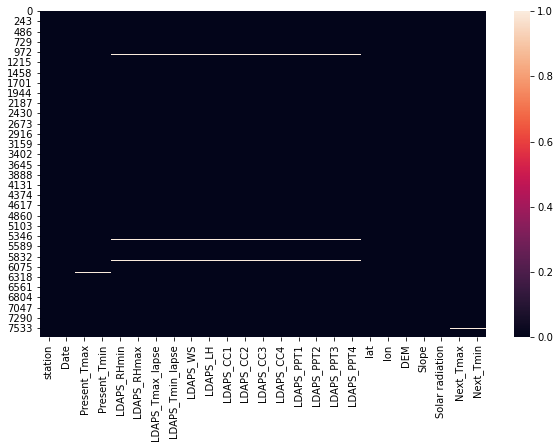

In [11]:
# Lets visualize the null values clearly
plt.figure(figsize=(10,6))
sns.heatmap(df.isnull())
plt.show()

The white lines represents the missing values in the dataset.

### Treating Null values

In [12]:
# Checking unique values in station column
df['station'].unique()

array([ 1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12., 13.,
       14., 15., 16., 17., 18., 19., 20., 21., 22., 23., 24., 25., nan])

* From the dataset we can notice that there are 25 stations and the data is collected from each station everyday starts from 1 ends at 25th station and the process is repeating.
* By checking the unique values we can say that the station column has missing values in the last two records i.e the null values in station column is present after 25th. So we will replace the null values by considering it as a next day.

In [13]:
# Filling null values in "station" column
df['station'].iloc[7750] = 1.0
df['station'].iloc[7751] = 2.0

Similarly in Date column, the last two records are missing so we can fill it with next date i.e,31-08-2017 using iloc method.

In [14]:
# Filling null values in "Date" column
df['Date'].iloc[7750] = '31-08-2017'
df['Date'].iloc[7751] = '31-08-2017'

Lets fill other columns by checking skewness.

In [15]:
# Checking skewness
df.skew()

station             0.000182
Present_Tmax       -0.262942
Present_Tmin       -0.365875
LDAPS_RHmin         0.298765
LDAPS_RHmax        -0.850870
LDAPS_Tmax_lapse   -0.226775
LDAPS_Tmin_lapse   -0.578943
LDAPS_WS            1.571581
LDAPS_LH            0.670491
LDAPS_CC1           0.457231
LDAPS_CC2           0.470060
LDAPS_CC3           0.637630
LDAPS_CC4           0.663251
LDAPS_PPT1          5.367675
LDAPS_PPT2          5.747360
LDAPS_PPT3          6.425829
LDAPS_PPT4          6.792379
lat                 0.087062
lon                -0.285213
DEM                 1.723257
Slope               1.563020
Solar radiation    -0.511210
Next_Tmax          -0.339607
Next_Tmin          -0.403743
dtype: float64

* The columnsLDAPS_RHmax, LDAPS_Tmin_Lapse, LDAPS_WS, LDAPS_LH,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PP2,LDAPS_PPT3 and LDAPS_PPT4 have skewness which means the data is not symmetric also the outliers are present in those column. So we will use median method to fill the null values in those columns.
* For the remaining columns we will use mean value to fill the null values.

In [16]:
# Checking the mean values of the column
print("The mean of Present_Tmax is:",df['Present_Tmax'].mean())
print("The mean of Present_Tmin is:",df['Present_Tmin'].mean())
print("The mean of LDAPS_RHmin is:",df['LDAPS_RHmin'].mean())
print("The mean of LDAPS_Tmax_lapse is:",df['LDAPS_Tmax_lapse'].mean())
print("The mean of LDAPS_CC1 is:",df['LDAPS_CC1'].mean())
print("The mean of LDAPS_CC2 is:",df['LDAPS_CC2'].mean())
print("The mean of Next_Tmax is:",df['Next_Tmax'].mean())
print("The mean of Next_Tmin is:",df['Next_Tmin'].mean())

The mean of Present_Tmax is: 29.76821140328037
The mean of Present_Tmin is: 23.22505857849521
The mean of LDAPS_RHmin is: 56.75937215069287
The mean of LDAPS_Tmax_lapse is: 29.613446542813577
The mean of LDAPS_CC1 is: 0.36877358559828194
The mean of LDAPS_CC2 is: 0.35608043728396527
The mean of Next_Tmax is: 30.274886731391593
The mean of Next_Tmin is: 22.93222006472492


In [17]:
# Filling missing values in thr above columns using mean method
cols = ["Present_Tmax","Present_Tmin","LDAPS_RHmin","LDAPS_Tmax_lapse","LDAPS_CC1","LDAPS_CC2","Next_Tmax","Next_Tmin"]
for i in cols:
    df[i] = df[i].replace(np.nan,df[i].mean())

So we have replaced the nan values present in the columns with their respective mean values.

In [18]:
# Checking the median values of the columns having outliers
print("The median of LDAPS_RHmax is :",df["LDAPS_RHmax"].median())
print("The median of LDAPS_Tmin_lapse is :",df["LDAPS_Tmin_lapse"].median())
print("The median of LDAPS_WS is :",df["LDAPS_WS"].median())
print("The median of LDAPS_LH is :",df["LDAPS_LH"].median())
print("The median of LDAPS_CC3 is :",df["LDAPS_CC3"].median())
print("The median of LDAPS_CC4 is :",df["LDAPS_CC4"].median())
print("The median of LDAPS_PPT1 is :",df["LDAPS_PPT1"].median())
print("The median of LDAPS_PPT2 is :",df["LDAPS_PPT2"].median())
print("The median of LDAPS_PPT3 is :",df["LDAPS_PPT3"].median())
print("The median of LDAPS_PPT4 is :",df["LDAPS_PPT4"].median())

The median of LDAPS_RHmax is : 89.79347992
The median of LDAPS_Tmin_lapse is : 23.76019884
The median of LDAPS_WS is : 6.547470301
The median of LDAPS_LH is : 56.86548154
The median of LDAPS_CC3 is : 0.262554604
The median of LDAPS_CC4 is : 0.227664469
The median of LDAPS_PPT1 is : 0.0
The median of LDAPS_PPT2 is : 0.0
The median of LDAPS_PPT3 is : 0.0
The median of LDAPS_PPT4 is : 0.0


In [19]:
# Filling missing values in the above columns using median method
cols = ["LDAPS_RHmax","LDAPS_Tmin_lapse","LDAPS_WS","LDAPS_LH","LDAPS_CC3","LDAPS_CC4","LDAPS_PPT1","LDAPS_PPT2","LDAPS_PPT3","LDAPS_PPT4"]
for i in cols:
    df[i] = df[i].replace(np.nan,df[i].median())

We have filled the null values with mean and median values. Lets check again if any null values left.

In [20]:
# Checking null values again
df.isnull().sum()

station             0
Date                0
Present_Tmax        0
Present_Tmin        0
LDAPS_RHmin         0
LDAPS_RHmax         0
LDAPS_Tmax_lapse    0
LDAPS_Tmin_lapse    0
LDAPS_WS            0
LDAPS_LH            0
LDAPS_CC1           0
LDAPS_CC2           0
LDAPS_CC3           0
LDAPS_CC4           0
LDAPS_PPT1          0
LDAPS_PPT2          0
LDAPS_PPT3          0
LDAPS_PPT4          0
lat                 0
lon                 0
DEM                 0
Slope               0
Solar radiation     0
Next_Tmax           0
Next_Tmin           0
dtype: int64

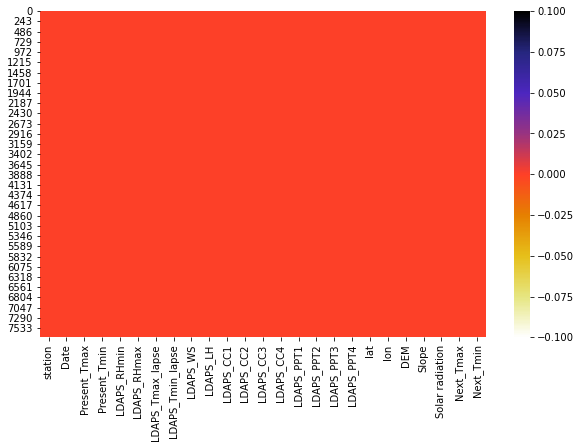

In [21]:
# Lets visualize the null values
plt.figure(figsize=(10,6))
sns.heatmap(df.isnull(),cmap="CMRmap_r")
plt.show()

S it is clear that there are no missing values present and we can move ahead.

In [22]:
# Lets shuffle the dataset
df = shuffle(df)
df


,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
5837,13.0,16-08-2016,35.4,27.6,34.987228,82.896393,34.149833,25.226180,5.461130,58.780405,0.004022,0.007537,0.020811,0.092094,0.000000,0.000000,0.000000,0.000000,37.5776,127.083,59.8324,2.6865,4917.379883,34.7,25.8
5995,21.0,22-08-2016,33.9,26.9,34.832619,71.705269,34.592346,25.166330,6.745301,14.679706,0.021072,0.002549,0.118135,0.337243,0.000000,0.000000,0.000000,0.000000,37.5507,127.040,26.2980,0.5721,4723.027344,31.9,26.6
7479,5.0,20-08-2017,25.0,21.9,84.737495,95.466858,27.846051,23.635983,8.820574,59.013535,0.768728,0.608679,0.815159,0.518501,1.297794,0.059224,4.807617,0.000000,37.5507,127.135,35.0380,0.5055,4822.092285,28.8,23.3
4543,19.0,26-08-2015,24.9,18.4,37.753532,92.758827,28.233194,20.850640,7.222731,37.695517,0.241559,0.212595,0.040632,0.036497,0.000000,0.000000,0.000000,0.000000,37.5776,126.938,75.0924,1.7678,4650.964355,29.8,20.1
320,21.0,12-07-2013,24.7,23.5,91.126266,95.286072,25.843409,23.270765,6.174057,32.577737,0.890305,0.947379,0.905626,0.935493,6.339810,6.740701,0.689005,0.045661,37.5507,127.040,26.2980,0.5721,5756.556641,25.4,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5505,6.0,03-08-2016,33.8,24.9,40.814709,83.266594,35.278243,26.587176,5.352375,52.845979,0.284943,0.065606,0.083580,0.063233,0.000000,0.000000,0.000000,0.000000,37.5102,127.042,54.6384,0.1457,5328.801758,35.5,26.5
57,8.0,02-07-2013,27.8,23.2,54.792088,91.937553,28.764731,20.727513,9.053970,47.794772,0.276732,0.219182,0.030873,0.004855,0.000000,0.000000,0.000000,0.000000,37.4697,126.910,52.5180,1.5629,5852.468262,30.0,20.3
2475,1.0,06-08-2014,22.8,20.3,61.983395,98.228371,26.499361,21.034378,5.658450,77.778620,0.655144,0.567612,0.513970,0.161410,0.004397,0.127559,0.398209,0.000000,37.6046,126.991,212.3350,2.7850,5415.057617,24.8,20.2
432,8.0,17-07-2013,26.4,23.4,73.263000,93.741669,27.162298,24.438185,5.884680,25.986054,0.569781,0.618961,0.613701,0.299167,0.035559,0.098596,0.000000,0.000000,37.4697,126.910,52.5180,1.5629,5689.650879,28.5,23.9


In [23]:
# Checking the dtypes of varaibles
df.dtypes

station             float64
Date                 object
Present_Tmax        float64
Present_Tmin        float64
LDAPS_RHmin         float64
LDAPS_RHmax         float64
LDAPS_Tmax_lapse    float64
LDAPS_Tmin_lapse    float64
LDAPS_WS            float64
LDAPS_LH            float64
LDAPS_CC1           float64
LDAPS_CC2           float64
LDAPS_CC3           float64
LDAPS_CC4           float64
LDAPS_PPT1          float64
LDAPS_PPT2          float64
LDAPS_PPT3          float64
LDAPS_PPT4          float64
lat                 float64
lon                 float64
DEM                 float64
Slope               float64
Solar radiation     float64
Next_Tmax           float64
Next_Tmin           float64
dtype: object

* We can observe only Date column is object rest all columns are of float datatype.
* As date cant be object datatype we will convert it as datetime type.

In [24]:
# Converting Date column from object to datetime
df["Date"]= pd.to_datetime(df["Date"])

In [25]:
df.dtypes

station                    float64
Date                datetime64[ns]
Present_Tmax               float64
Present_Tmin               float64
LDAPS_RHmin                float64
LDAPS_RHmax                float64
LDAPS_Tmax_lapse           float64
LDAPS_Tmin_lapse           float64
LDAPS_WS                   float64
LDAPS_LH                   float64
LDAPS_CC1                  float64
LDAPS_CC2                  float64
LDAPS_CC3                  float64
LDAPS_CC4                  float64
LDAPS_PPT1                 float64
LDAPS_PPT2                 float64
LDAPS_PPT3                 float64
LDAPS_PPT4                 float64
lat                        float64
lon                        float64
DEM                        float64
Slope                      float64
Solar radiation            float64
Next_Tmax                  float64
Next_Tmin                  float64
dtype: object

The Date column has been converted to Datetime type, now lets extract day, month and year from it.

In [26]:
# Extracting day, month and year from Date column
df["Day"] = df["Date"].dt.day
df["Month"] = df["Date"].dt.month
df["Year"] = df["Date"].dt.year

As we have extracted day, month and year, now we can drop Date column.

In [27]:
# Dropping "Date" column
df.drop("Date",axis=1,inplace=True)

In [28]:
df.head()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Day,Month,Year
5837,13.0,35.4,27.6,34.987228,82.896393,34.149833,25.226180,5.461130,58.780405,0.004022,0.007537,0.020811,0.092094,0.000000,0.000000,0.000000,0.000000,37.5776,127.083,59.8324,2.6865,4917.379883,34.7,25.8,16,8,2016
5995,21.0,33.9,26.9,34.832619,71.705269,34.592346,25.166330,6.745301,14.679706,0.021072,0.002549,0.118135,0.337243,0.000000,0.000000,0.000000,0.000000,37.5507,127.040,26.2980,0.5721,4723.027344,31.9,26.6,22,8,2016
7479,5.0,25.0,21.9,84.737495,95.466858,27.846051,23.635983,8.820574,59.013535,0.768728,0.608679,0.815159,0.518501,1.297794,0.059224,4.807617,0.000000,37.5507,127.135,35.0380,0.5055,4822.092285,28.8,23.3,20,8,2017
4543,19.0,24.9,18.4,37.753532,92.758827,28.233194,20.850640,7.222731,37.695517,0.241559,0.212595,0.040632,0.036497,0.000000,0.000000,0.000000,0.000000,37.5776,126.938,75.0924,1.7678,4650.964355,29.8,20.1,26,8,2015
320,21.0,24.7,23.5,91.126266,95.286072,25.843409,23.270765,6.174057,32.577737,0.890305,0.947379,0.905626,0.935493,6.339810,6.740701,0.689005,0.045661,37.5507,127.040,26.2980,0.5721,5756.556641,25.4,22.5,7,12,2013


In [29]:
# Checking the number of unique values in each column
df.nunique()

station               25
Present_Tmax         168
Present_Tmin         156
LDAPS_RHmin         7673
LDAPS_RHmax         7664
LDAPS_Tmax_lapse    7676
LDAPS_Tmin_lapse    7675
LDAPS_WS            7675
LDAPS_LH            7675
LDAPS_CC1           7570
LDAPS_CC2           7583
LDAPS_CC3           7599
LDAPS_CC4           7524
LDAPS_PPT1          2812
LDAPS_PPT2          2510
LDAPS_PPT3          2356
LDAPS_PPT4          1918
lat                   12
lon                   25
DEM                   25
Slope                 27
Solar radiation     1575
Next_Tmax            184
Next_Tmin            158
Day                   21
Month                 12
Year                   5
dtype: int64

In [30]:
# Checking the list of counts of Target columns
print(df['Next_Tmax'].value_counts())
print("\n")
print(df['Next_Tmin'].value_counts())

29.3    113
33.0    106
31.3    104
29.6    101
31.2     98
       ... 
20.9      1
18.9      1
18.6      1
37.4      1
19.7      1
Name: Next_Tmax, Length: 184, dtype: int64


23.5    159
23.4    157
24.0    156
23.2    150
23.8    149
       ... 
13.4      1
12.9      1
28.2      1
29.5      1
13.6      1
Name: Next_Tmin, Length: 158, dtype: int64


# Description of Dataset

In [31]:
# statistical Summary of dataset
df.describe()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Day,Month,Year
count,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000
mean,12.997033,29.768211,23.225059,56.759372,88.388529,29.613447,23.514984,7.092549,62.450457,0.368774,0.356080,0.317864,0.298499,0.586267,0.480310,0.275508,0.266801,37.544722,126.991397,61.867972,1.257048,5341.502803,30.274887,22.932220,16.374742,7.080882,2015.000516
std,7.213007,2.956557,2.403036,14.596973,7.158471,2.932898,2.334099,2.173913,33.571540,0.261185,0.256810,0.249208,0.253211,1.937198,1.754900,1.156495,1.200654,0.050352,0.079435,54.279780,1.370444,429.158867,3.122557,2.483276,8.243617,2.238124,1.414487
min,1.000000,20.000000,11.300000,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,37.456200,126.826000,12.370000,0.098475,4329.520508,17.400000,11.300000,7.000000,1.000000,2013.000000
25%,7.000000,27.800000,21.700000,46.046162,84.316923,27.693091,22.114651,5.686487,37.532764,0.148321,0.142328,0.103100,0.082741,0.000000,0.000000,0.000000,0.000000,37.510200,126.937000,28.700000,0.271300,4999.018555,28.200000,21.400000,8.000000,7.000000,2014.000000
50%,13.000000,29.900000,23.400000,55.313244,89.793480,29.662273,23.760199,6.547470,56.865482,0.320110,0.315667,0.262555,0.227664,0.000000,0.000000,0.000000,0.000000,37.550700,126.995000,45.716000,0.618000,5436.345215,30.500000,23.100000,16.000000,7.000000,2015.000000
75%,19.000000,32.000000,24.900000,67.038254,93.704500,31.683819,25.134000,8.007471,83.904586,0.571696,0.554963,0.494007,0.497230,0.049122,0.016748,0.007231,0.000000,37.577600,127.042000,59.832400,1.767800,5728.316406,32.600000,24.600000,24.000000,8.000000,2016.000000
max,25.000000,37.600000,29.900000,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,0.967277,0.968353,0.983789,0.974710,23.701544,21.621661,15.841235,16.655469,37.645000,127.135000,212.335000,5.178230,5992.895996,38.900000,29.800000,31.000000,12.000000,2017.000000


This provides the statistical information of the dataset. The summary of the dataset looks perfect as there is no negative/invalid data present in the dataset.
From the above description we can observe the following things:
* The counts of the columns are same which means there are no missing values present in the dataset.
* In most of the columns, mean is greater than the median(50%),which means theey are skewed to the right.
* Some column like LDAPS_RHmax, Solar radiation etc, have median values bit greater than the mean value i.e they are skewed to the left
* Also the columns like station, present_Tmax, lon, lat have same mean and median values which means he dat is normal and symmetric, also they have no skewness.
* There is a huge difference between the 75th percentile and max, so outliers are present.

# Data Visualization

## Univariate Analysis

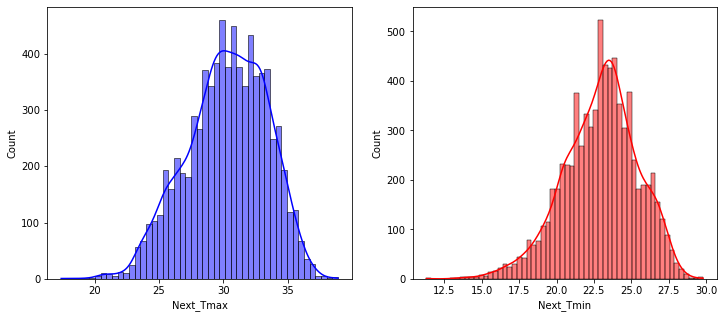

In [32]:
# Plotting histogram for target variables
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
sns.histplot(df['Next_Tmax'],kde=True,color='b')
plt.subplot(1,2,2)
sns.histplot(df['Next_Tmin'],kde=True,color='r')
plt.show()

From the above plot we can observe that the data is normally distributed in both the target variables "Next_Tmax" and "Next_Tmin",and as the data is symmetric, there is no skewness present in these columns.

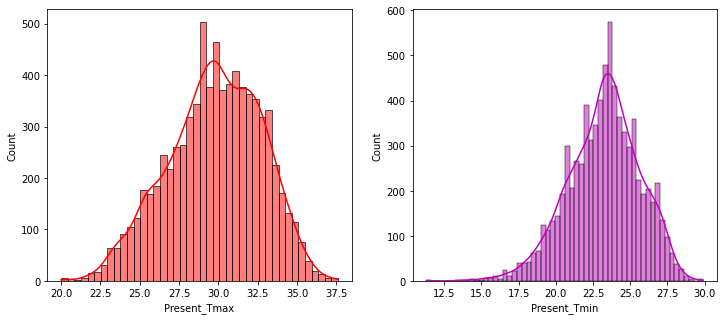

In [33]:
# Plotting histogram for present_Tmax and present_Tmin variables
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
sns.histplot(df['Present_Tmax'],kde=True,color='r')
plt.subplot(1,2,2)
sns.histplot(df['Present_Tmin'],kde=True,color='m')
plt.show()

Here also the data is symmetric and normally distributed in both the columns and there is no skewness present.

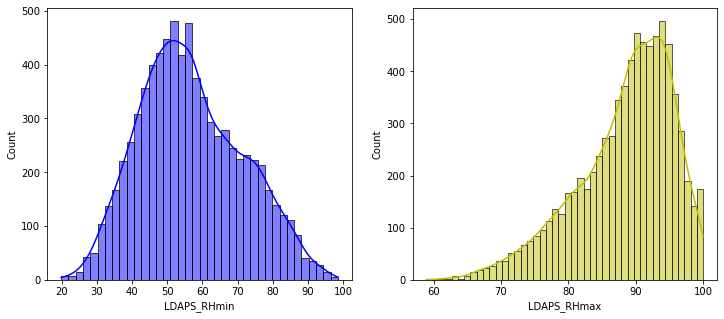

In [34]:
# Plotting histographs for LDAPS_RHmin and LDAPS_RHmax variables 
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
sns.histplot(df['LDAPS_RHmin'],kde=True,color='b')
plt.subplot(1,2,2)
sns.histplot(df['LDAPS_RHmax'],kde=True,color='y')
plt.show()

* The data is symmetric and normally distributed in LDAPS_RHmin columns and there is no skewness.
* The data is almost normal in LDAPS_RHmax column but it is skewed to the left, since the median is more than the mean.

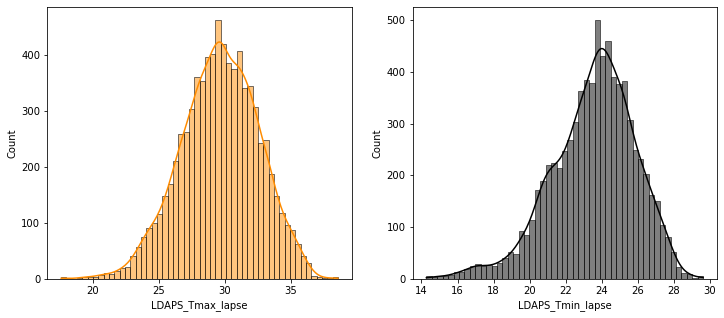

In [35]:
# Plotting histographs for LDAPS_Tmax_lapse and LDAPS_Tmin_lapse variables 
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
sns.histplot(df['LDAPS_Tmax_lapse'],kde=True,color='darkorange')
plt.subplot(1,2,2)
sns.histplot(df['LDAPS_Tmin_lapse'],kde=True,color='black')
plt.show()

* The data is normally distributed in both the columns.
* There is no skewness in the column LDAPS_Tmax_lapse but the column LDAPS_Tmin_lapse is bit skewed to left.

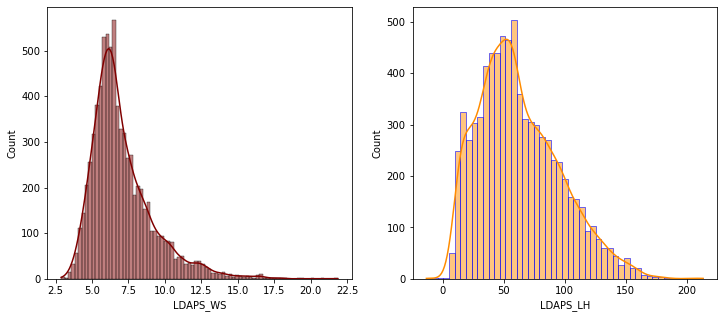

In [36]:
# Plotting histographs for LDAPS_WS and LDAPS_LH variables 
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
sns.histplot(df['LDAPS_WS'],kde=True,color='maroon')
plt.subplot(1,2,2)
sns.histplot(df['LDAPS_LH'],kde=True,color='darkorange',edgecolor="b")
plt.show()

The data is almost normal in both the columns but median is greater than the mean and hence they are skewed to the right.

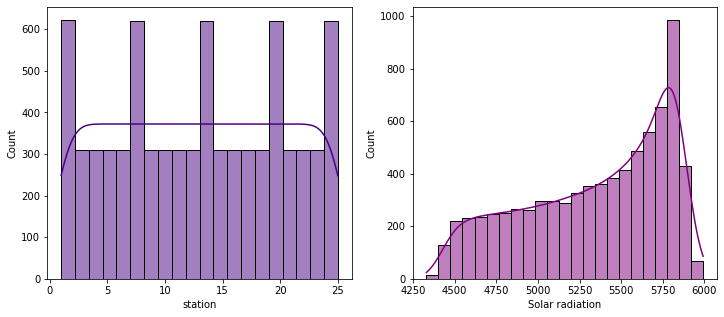

In [37]:
# Plotting histographs for station and Solar radiation variables 
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
sns.histplot(df['station'],kde=True,color='indigo')
plt.subplot(1,2,2)
sns.histplot(df['Solar radiation'],kde=True,color="purple")
plt.show()

* The data is normally distributed in station column and there is no skewness present in this column.
* The mean is less than median in Solar radiation column so the data is skewed to left in this column.

#### Distribution of plots using distplot

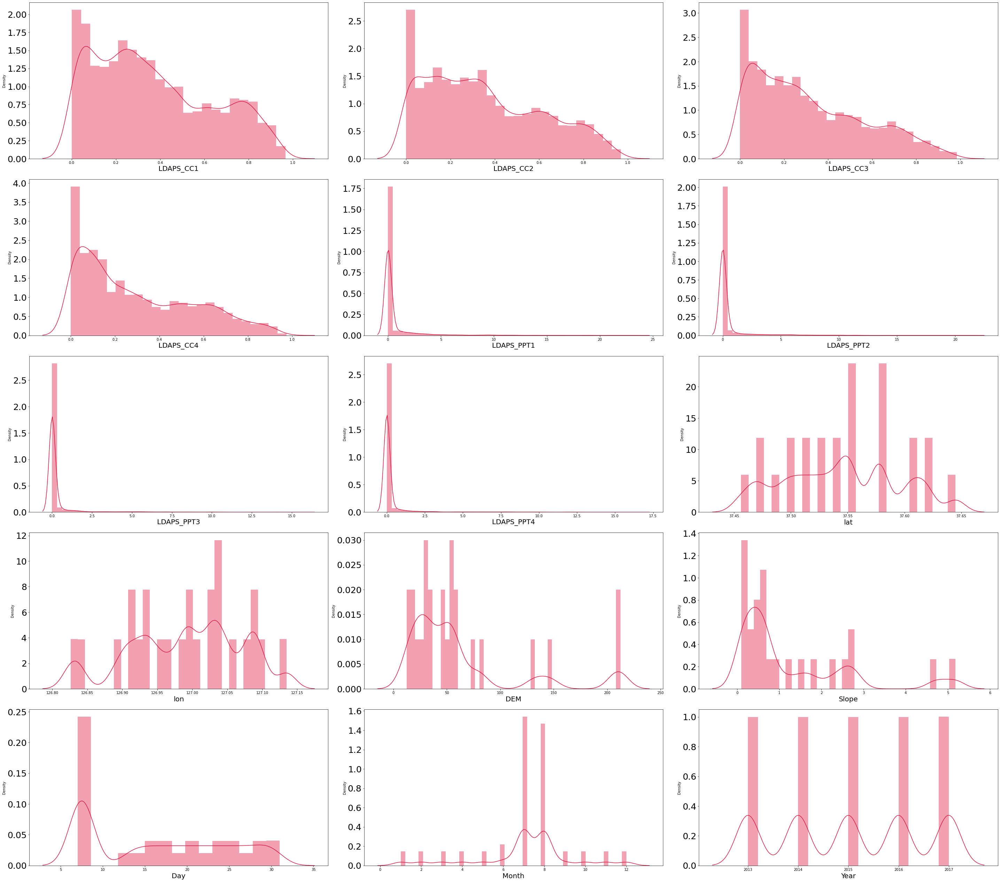

In [38]:
# Lets check how the data has been distributed in remaining columns
plt.figure(figsize=(40,70),facecolor="white")
plotnumber=1
for col in df.columns.drop(["Next_Tmax","Next_Tmin","Solar radiation"]):
    if plotnumber>=10:
        ax = plt.subplot(10,3,plotnumber)
        sns.distplot(df[col],color='crimson')
        plt.xlabel(col,fontsize=20)
        plt.yticks(rotation=0,fontsize=25)
    plotnumber+=1
plt.tight_layout()

* From the above distribution plot we can observe that the data is almost normal in first three columns but they are skewed to right.
* Most of the columns have right skewness and the data is not normal in those columns.

## Bivariate Analysis

<AxesSubplot:xlabel='station', ylabel='Next_Tmin'>

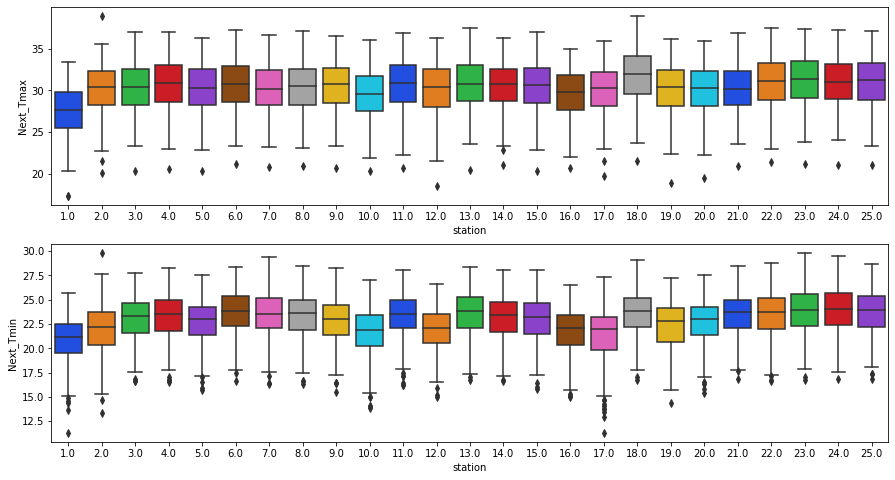

In [39]:
# Visualizing the realtion between station and target variables
plt.figure(figsize=(15,8))
plt.subplot(2,1,1)
sns.boxplot(df['station'],df['Next_Tmax'],data=df,palette="bright")
plt.subplot(2,1,2)
sns.boxplot(df['station'],df['Next_Tmin'],data=df,palette="bright")

From the box plot we can notice the station 18 has highest temperature collection for both Next_Tmax and Next_Tmin targets while station 1 observes lowest temperature for both the targets. This could be because of the stations location

<AxesSubplot:title={'center':'Next day min temperature Vs Present day max temperature'}, xlabel='Present_Tmin', ylabel='Next_Tmax'>

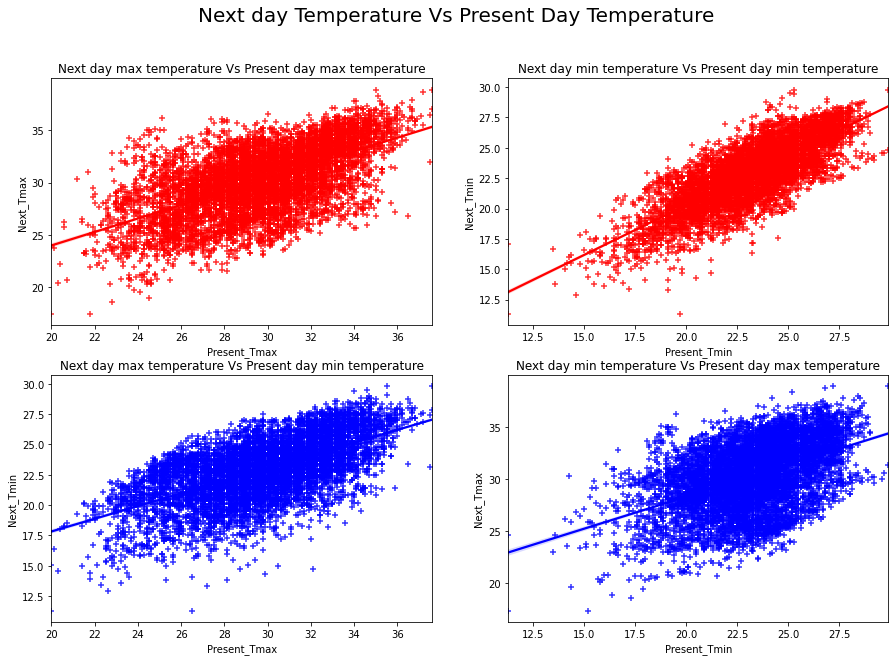

In [40]:
# Comparing Next day temperature and Present day temperature

plt.figure(figsize=(15,10))
plt.suptitle("Next day Temperature Vs Present Day Temperature",fontsize=20)

plt.subplot(2,2,1)
plt.title("Next day max temperature Vs Present day max temperature")
sns.regplot(x="Present_Tmax",y = "Next_Tmax",data=df,marker="+",color='r')

plt.subplot(2,2,2)
plt.title("Next day min temperature Vs Present day min temperature")
sns.regplot(x="Present_Tmin",y = "Next_Tmin",data=df,marker="+",color='r')

plt.subplot(2,2,3)
plt.title("Next day max temperature Vs Present day min temperature")
sns.regplot(x="Present_Tmax",y = "Next_Tmin",data=df,marker="+",color="b")

plt.subplot(2,2,4)
plt.title("Next day min temperature Vs Present day max temperature")
sns.regplot(x="Present_Tmin",y = "Next_Tmax",data=df,marker="+",color='b')

* Present_Tmax and Present_Tmin columns contains the data of maximum and minimum air temperature of the present day.
* There is a strong linear relationship between the Next day temperature and Present day temperature.
* Present_Tmin column has bit less relation with Next_Tmin compared to others.
* As Present day Tmax and Tmin increases then Next_Tmin and Next_Tmax temperature also increases

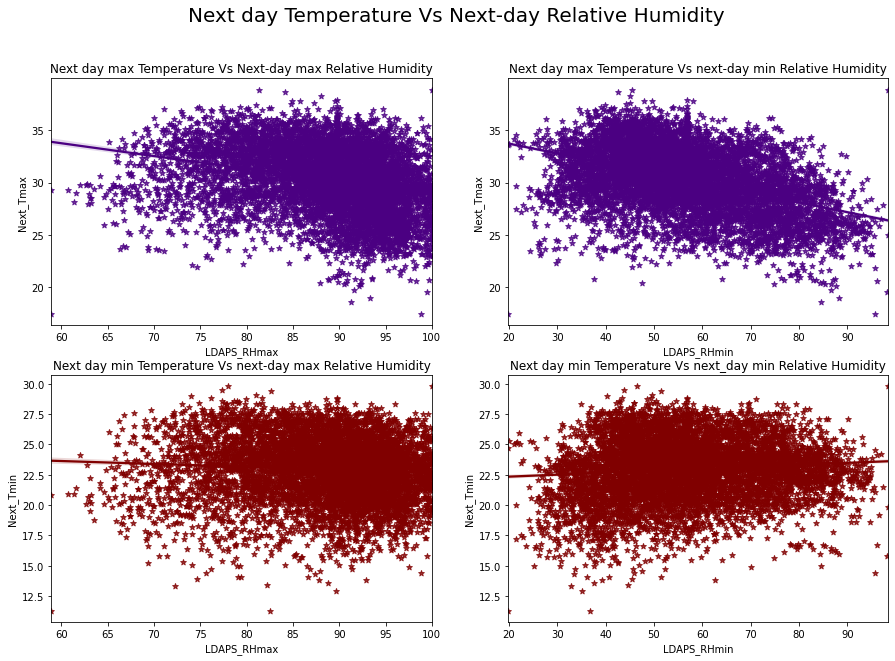

In [41]:
# Comparing Next day temperature and next day Relative Humidity

plt.figure(figsize=(15,10))
plt.suptitle('Next day Temperature Vs Next-day Relative Humidity',fontsize=20)

plt.subplot(2,2,1)
plt.title('Next day max Temperature Vs Next-day max Relative Humidity')
sns.regplot(x='LDAPS_RHmax',y='Next_Tmax',data=df,marker="*",color='indigo')

plt.subplot(2,2,2)
plt.title('Next day max Temperature Vs next-day min Relative Humidity')
sns.regplot(x='LDAPS_RHmin',y='Next_Tmax',data=df,marker="*",color='indigo')

plt.subplot(2,2,3)
plt.title('Next day min Temperature Vs next-day max Relative Humidity')
sns.regplot(x='LDAPS_RHmax',y='Next_Tmin',data=df,marker="*",color='maroon')

plt.subplot(2,2,4)
plt.title('Next day min Temperature Vs next_day min Relative Humidity')
sns.regplot(x='LDAPS_RHmin',y='Next_Tmin',data=df,marker="*",color="maroon")
plt.show()

* The columns LDAPS_RHmax and LDAPS_RHmin contains the forecast of next-day maximum and minimum Relative humidity in percentage(%) respectively.
* Next day Tmax decreases with increase in LDAPS_RHmax and LDAPS_RHmin but it is not true in case of Next_Tmin, as Next day Tmin seems to be unaffected by RHmax and we can also observe slight positive correlation between Next_Tmin and RHmin.

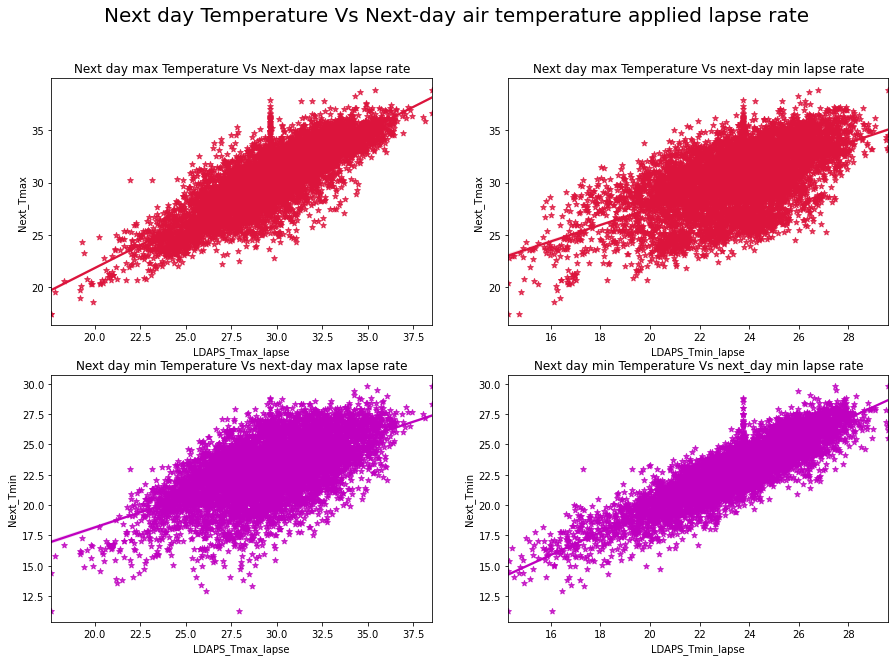

In [42]:
# Comparing Next day temperature and next day air temperature applied lapse rate (Â°C)

plt.figure(figsize=(15,10))
plt.suptitle('Next day Temperature Vs Next-day air temperature applied lapse rate',fontsize=20)

plt.subplot(2,2,1)
plt.title('Next day max Temperature Vs Next-day max lapse rate')
sns.regplot(x='LDAPS_Tmax_lapse',y='Next_Tmax',data=df,marker="*",color='crimson')

plt.subplot(2,2,2)
plt.title('Next day max Temperature Vs next-day min lapse rate')
sns.regplot(x='LDAPS_Tmin_lapse',y='Next_Tmax',data=df,marker="*",color='crimson')

plt.subplot(2,2,3)
plt.title('Next day min Temperature Vs next-day max lapse rate')
sns.regplot(x='LDAPS_Tmax_lapse',y='Next_Tmin',data=df,marker="*",color='m')

plt.subplot(2,2,4)
plt.title('Next day min Temperature Vs next_day min lapse rate')
sns.regplot(x='LDAPS_Tmin_lapse',y='Next_Tmin',data=df,marker="*",color="m")
plt.show()

* LDAPS_Tmax_lapse and LDAPS_Tmin_lapse is forecast of next-day maximum and minimum air temperature applied lapse rate (Â°C) respectively.
* There is a strong positive linear relationship between target variables Next day temperature and Next day air temperature applied lapse rate.
* As Next day air temperature applied lapse rate increases, Next day temperature is also increasing. 

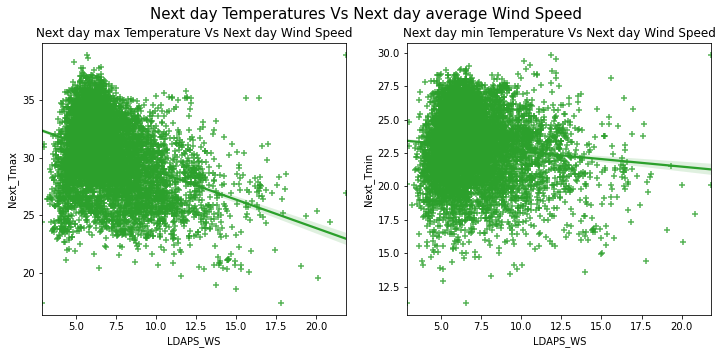

In [43]:
# Comparing Next day temperature and  Next day Average Wind Speed

plt.figure(figsize=(12,5))
plt.suptitle('Next day Temperatures Vs Next day average Wind Speed',fontsize=15)

plt.subplot(1,2,1)
plt.title('Next day max Temperature Vs Next day Wind Speed') 
sns.regplot(x='LDAPS_WS',y='Next_Tmax',data=df,marker='+',color="tab:green")

plt.subplot(1,2,2)
plt.title('Next day min Temperature Vs Next day Wind Speed') 
sns.regplot(x='LDAPS_WS',y='Next_Tmin',data=df,marker='+',color="tab:green")
plt.show()

* LDAPS_WS is forecast of next-day average wind speed in (m/s).
* There is very less relation of wind speed with the target variables. As wind speed increases, Next day temperature decreases also Next day Tmax seems to decrease more drastically compared to Next day Tmin.
* From the graph we can observe the Wind Speed is mostly 2.8 to 10 m/s.

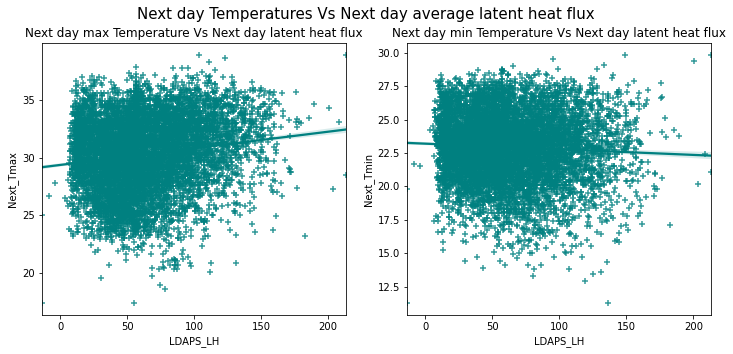

In [44]:
#Comparing Next day temperature and  Next day Average latent heat flux (W/m2)

plt.figure(figsize=(12,5))
plt.suptitle('Next day Temperatures Vs Next day average latent heat flux',fontsize=15)

plt.subplot(1,2,1)
plt.title('Next day max Temperature Vs Next day latent heat flux') 
sns.regplot(x='LDAPS_LH',y='Next_Tmax',data=df,marker='+',color="teal")

plt.subplot(1,2,2)
plt.title('Next day min Temperature Vs Next day latent heat flux') 
sns.regplot(x='LDAPS_LH',y='Next_Tmin',data=df,marker='+',color="teal")
plt.show()

* LDAPS_LH gives the forecast of next-day average latent heat flux (W/m2).
From the plot we can notice there is no linear relation between targets and the features.
* As Latent heat flux increases, Next day Tmax is also increases slightly while Next day Tmin decreases.
* The Latent heat flux mostly distributed in the range of 10 to 160 W/m2. 

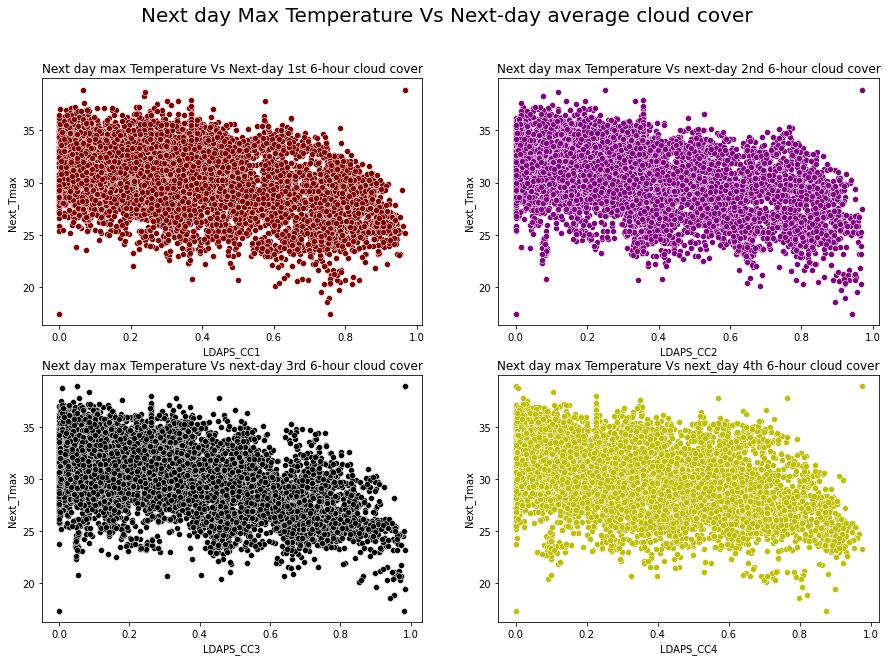

In [45]:
# Comparing Next day maximnum temperature and next day average cloud cover

plt.figure(figsize=(15,10))
plt.suptitle('Next day Max Temperature Vs Next-day average cloud cover',fontsize=20)

plt.subplot(2,2,1)
plt.title('Next day max Temperature Vs Next-day 1st 6-hour cloud cover')
sns.scatterplot(x='LDAPS_CC1',y='Next_Tmax',data=df,color="maroon")

plt.subplot(2,2,2)
plt.title('Next day max Temperature Vs next-day 2nd 6-hour cloud cover')
sns.scatterplot(x='LDAPS_CC2',y='Next_Tmax',data=df,color='purple')

plt.subplot(2,2,3)
plt.title('Next day max Temperature Vs next-day 3rd 6-hour cloud cover')
sns.scatterplot(x='LDAPS_CC3',y='Next_Tmax',data=df,color='k')

plt.subplot(2,2,4)
plt.title('Next day max Temperature Vs next_day 4th 6-hour cloud cover')
sns.scatterplot(x='LDAPS_CC4',y='Next_Tmax',data=df,color="y")
plt.show()

* By observing the plot we can infer that the column Next_Tmax goes on decreasing as the cloud cover increases irrespective of any split.
* The cloud cover liesin the range of 0 to 0.97%. Also we can say there is negative linear relation between the targets and the cloud cover.

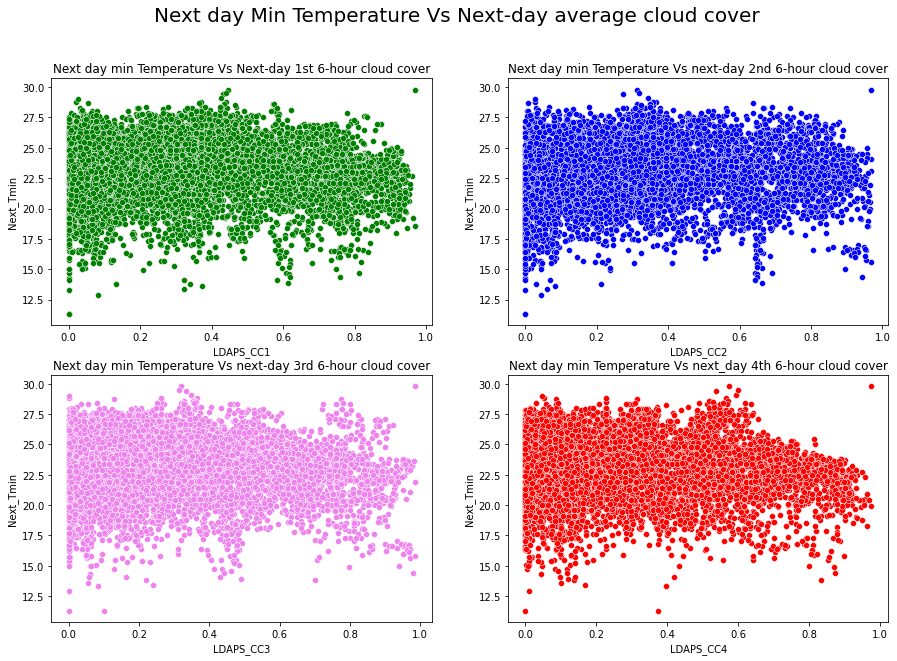

In [46]:
# Comparing Next day minimum temperature and next day average cloud cover

plt.figure(figsize=(15,10))
plt.suptitle('Next day Min Temperature Vs Next-day average cloud cover',fontsize=20)

plt.subplot(2,2,1)
plt.title('Next day min Temperature Vs Next-day 1st 6-hour cloud cover')
sns.scatterplot(x='LDAPS_CC1',y='Next_Tmin',data=df,color="g")

plt.subplot(2,2,2)
plt.title('Next day min Temperature Vs next-day 2nd 6-hour cloud cover')
sns.scatterplot(x='LDAPS_CC2',y='Next_Tmin',data=df,color='b')

plt.subplot(2,2,3)
plt.title('Next day min Temperature Vs next-day 3rd 6-hour cloud cover')
sns.scatterplot(x='LDAPS_CC3',y='Next_Tmin',data=df,color='violet')

plt.subplot(2,2,4)
plt.title('Next day min Temperature Vs next_day 4th 6-hour cloud cover')
sns.scatterplot(x='LDAPS_CC4',y='Next_Tmin',data=df,color="r")
plt.show()

* There is no significant relation between Next day temperature and cloud cover.
* We can say that Next_Tmin remains unaffected by cloud cover. And it ranges between 0-0.98% .

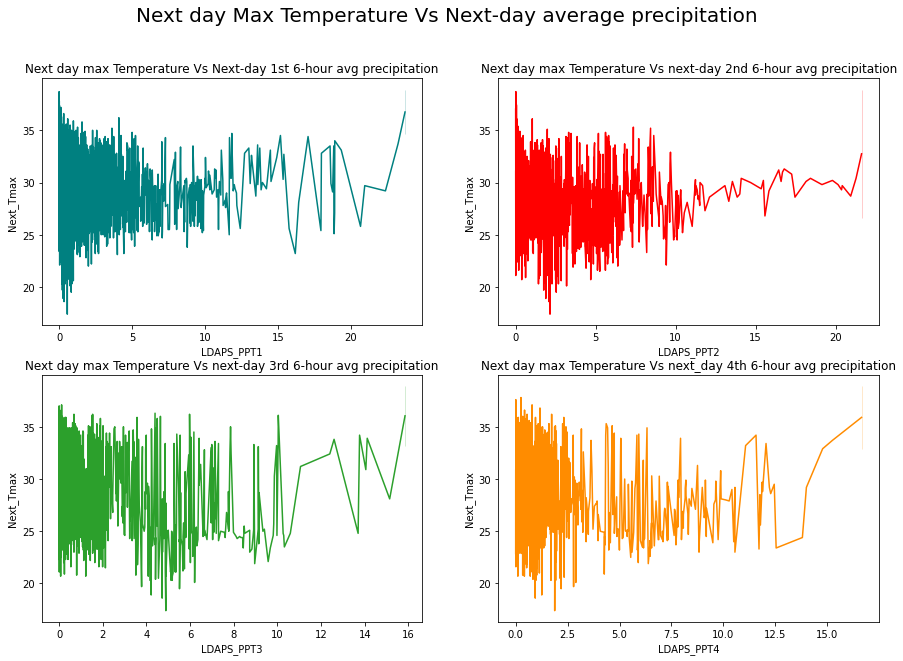

In [47]:
# Comparing Next day maximnum temperature and next day average precipitation

plt.figure(figsize=(15,10))
plt.suptitle('Next day Max Temperature Vs Next-day average precipitation',fontsize=20)

plt.subplot(2,2,1)
plt.title('Next day max Temperature Vs Next-day 1st 6-hour avg precipitation')
sns.lineplot(x='LDAPS_PPT1',y='Next_Tmax',data=df,color="teal")

plt.subplot(2,2,2)
plt.title('Next day max Temperature Vs next-day 2nd 6-hour avg precipitation')
sns.lineplot(x='LDAPS_PPT2',y='Next_Tmax',data=df,color='r')

plt.subplot(2,2,3)
plt.title('Next day max Temperature Vs next-day 3rd 6-hour avg precipitation')
sns.lineplot(x='LDAPS_PPT3',y='Next_Tmax',data=df,color='tab:green')

plt.subplot(2,2,4)
plt.title('Next day max Temperature Vs next_day 4th 6-hour avg precipitation')
sns.lineplot(x='LDAPS_PPT4',y='Next_Tmax',data=df,color="darkorange")
plt.show()

* There is no relation between average precipitation and Next day temperature.
* Next_Tmax decreases as average precipitation increases irrespective of any split.
* We can observe the average precipitation distributed mostly between 0-5% in PPT1, 0-10% in PPT2, 0-7% in PPT3 and 0-2.5% in PPT4.

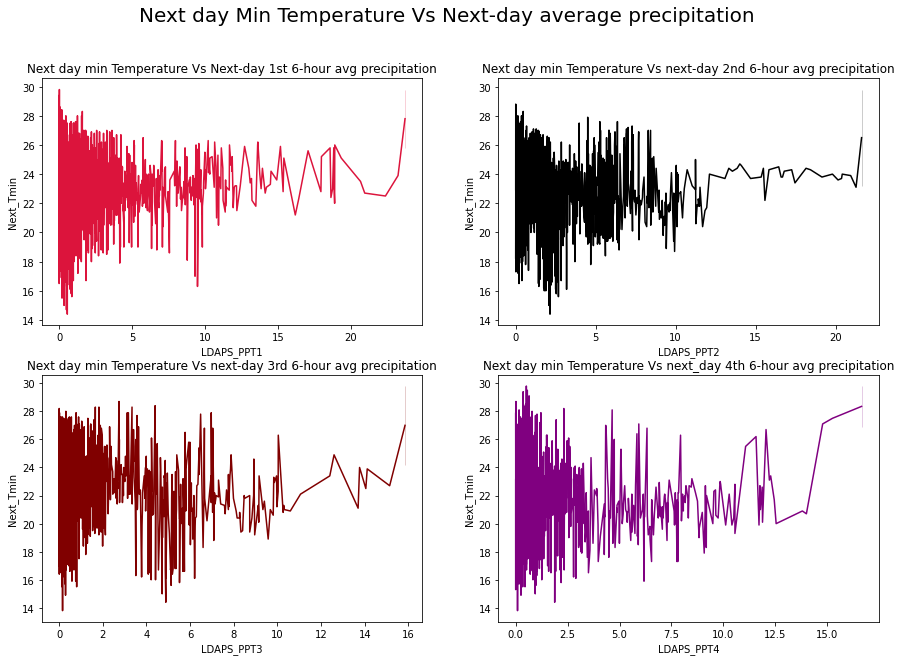

In [48]:
# Comparing Next day minimum temperature and next day average precipitation

plt.figure(figsize=(15,10))
plt.suptitle('Next day Min Temperature Vs Next-day average precipitation',fontsize=20)

plt.subplot(2,2,1)
plt.title('Next day min Temperature Vs Next-day 1st 6-hour avg precipitation')
sns.lineplot(x='LDAPS_PPT1',y='Next_Tmin',data=df,color="crimson")

plt.subplot(2,2,2)
plt.title('Next day min Temperature Vs next-day 2nd 6-hour avg precipitation')
sns.lineplot(x='LDAPS_PPT2',y='Next_Tmin',data=df,color='k')

plt.subplot(2,2,3)
plt.title('Next day min Temperature Vs next-day 3rd 6-hour avg precipitation')
sns.lineplot(x='LDAPS_PPT3',y='Next_Tmin',data=df,color='maroon')

plt.subplot(2,2,4)
plt.title('Next day min Temperature Vs next_day 4th 6-hour avg precipitation')
sns.lineplot(x='LDAPS_PPT4',y='Next_Tmin',data=df,color="purple")
plt.show()

* There is no linear relation between average precipitation and Next day temperature.
* Next_Tmin slightly increases as PPT1 and PPT2 increases also as LDAPS_PPT1 goes above 5% then Next_Tmin is above 15 degree.
* The Next_Tmin slightly decreases as LDAPS_PPT3 and LDAPS_PPT4 increases.

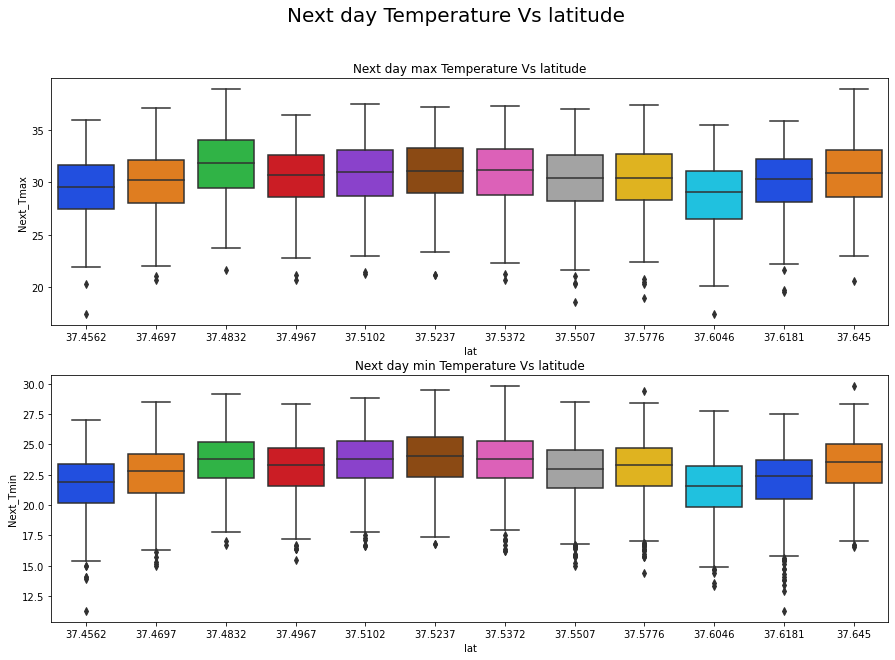

In [49]:
# Comparing Next day temperature and latitude

plt.figure(figsize=(15,10))
plt.suptitle('Next day Temperature Vs latitude',fontsize=20)

plt.subplot(2,1,1)
plt.title('Next day max Temperature Vs latitude')
sns.boxplot(x='lat',y='Next_Tmax',data=df,palette="bright")

plt.subplot(2,1,2)
plt.title('Next day min Temperature Vs latitude')
sns.boxplot(x='lat',y='Next_Tmin',data=df,palette="bright")
plt.show()

* The highest temperature is observed at latitude range 37.4832 for Next_Tmax but this is not the case for Next_Tmin, that could be because of other factors affect the temperature.
* Also the temperature seems to fall down as latitude increases in both the cases.

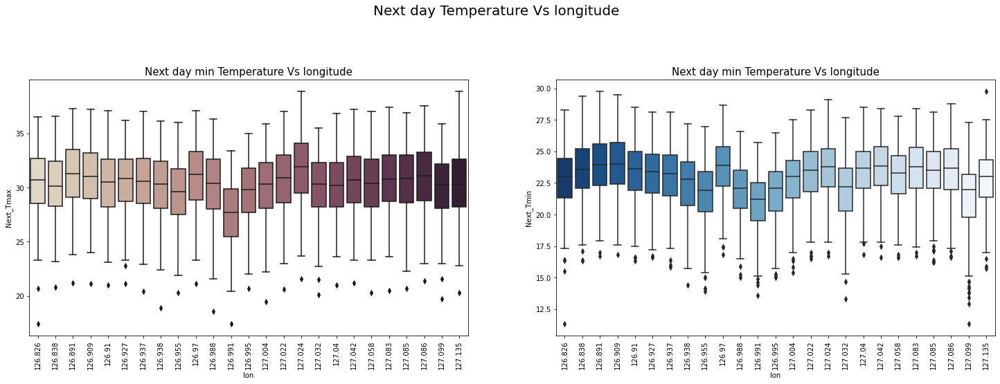

In [50]:
# Comparing Next day temperature and longitude

plt.figure(figsize=(25,15))
plt.suptitle('Next day Temperature Vs longitude',fontsize=20)

plt.subplot(2,2,1)
plt.title('Next day min Temperature Vs longitude',fontsize=15)
sns.boxplot(x='lon',y='Next_Tmax',data=df,palette="ch:.28")
plt.xticks(rotation=90)

plt.subplot(2,2,2)
plt.title('Next day min Temperature Vs longitude',fontsize=15)
sns.boxplot(x='lon',y='Next_Tmin',data=df,palette="Blues_r")
plt.xticks(rotation=90)
plt.show()

* From the graph we can say that longitude is not affecting much Next day temperature. As the longitude increases, Next_Tmax also increases for first three longitudes and then it decreases. This increase and decrease continuous tll the end.
* Same thing happens in the case of Next_Tmin also.

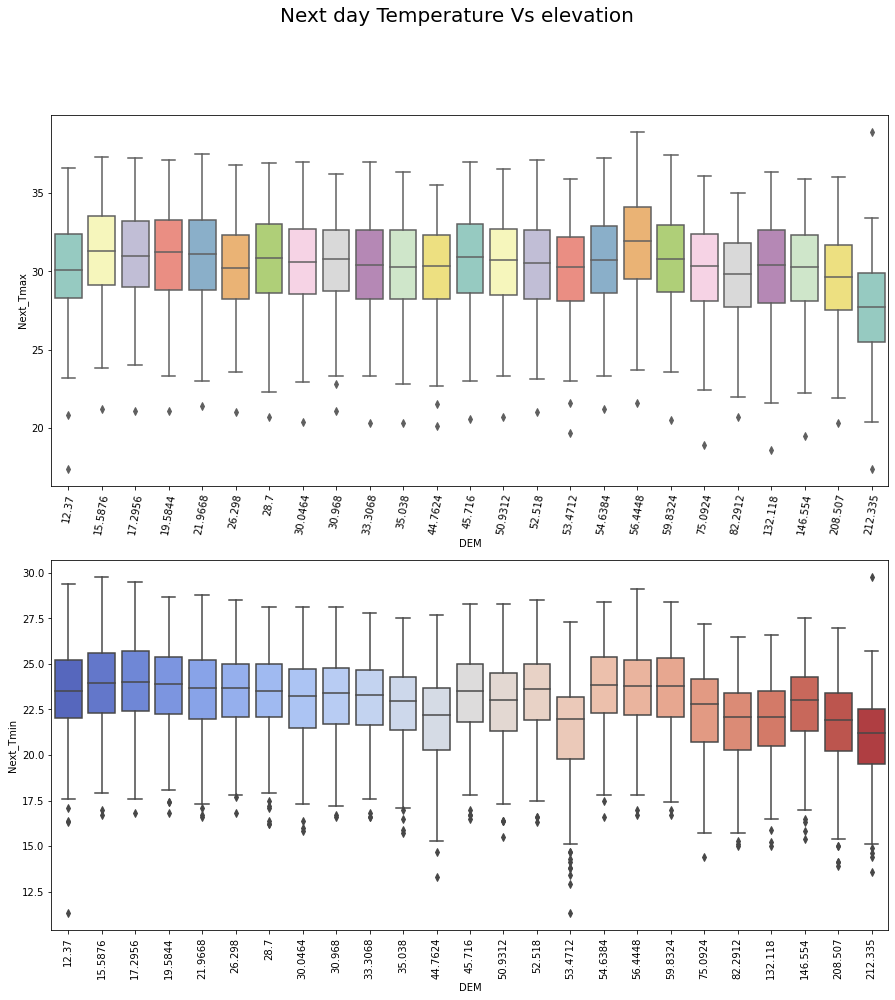

In [51]:
# Comparing Next day temperature and elevation

plt.figure(figsize=(15,15))
plt.suptitle('Next day Temperature Vs elevation',fontsize=20)

plt.subplot(2,1,1)
sns.boxplot(x='DEM',y='Next_Tmax',data=df,palette="Set3")
plt.xticks(rotation=80)

plt.subplot(2,1,2)
sns.boxplot(x='DEM',y='Next_Tmin',data=df,palette="coolwarm")
plt.xticks(rotation=90)
plt.show()

* The highest temperature is observed at the elevation56.4448 for Next_Tmax but this is not the case in Next_Tmin.
* In the first graph we can observe as the elevation increases, temperature decreases. This is true only for last 10 elevations, for remaining elevations are not affecting the temperature that much.
* In the second graph we can infer that the temperature decreases first and then increases and this increase and decrese of temperature is continuing till the end.

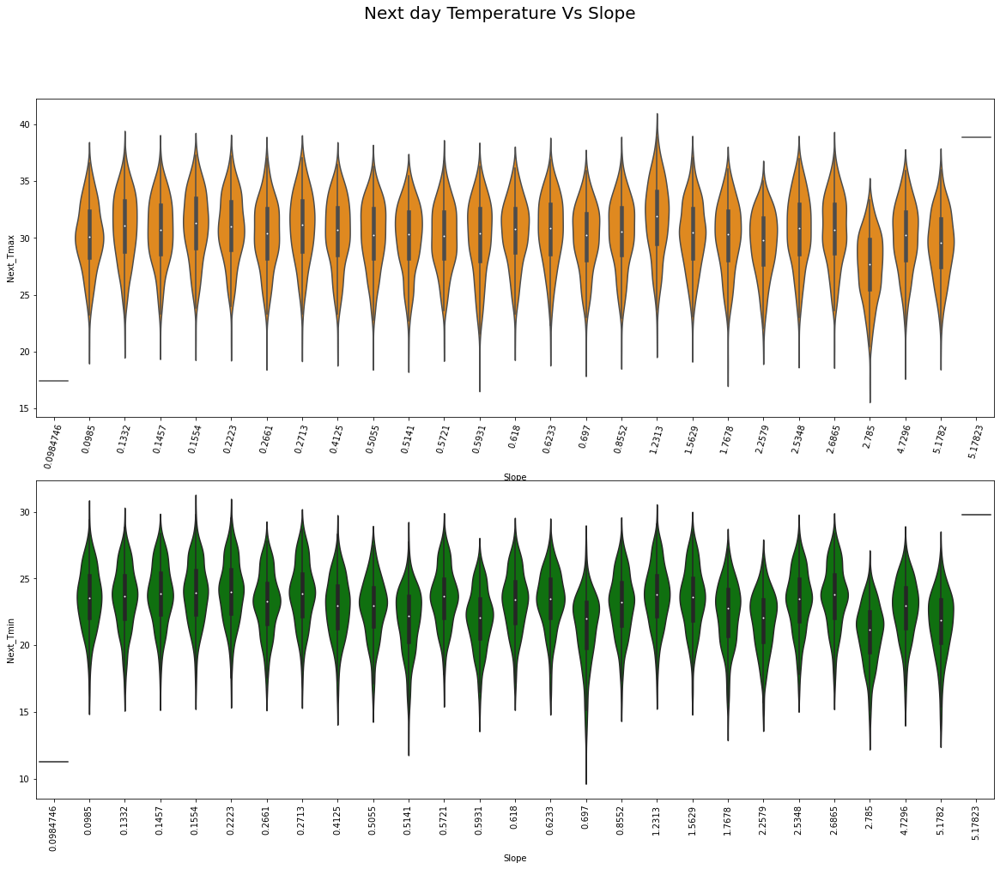

In [52]:
# Comparing Next day temperature and slope

plt.figure(figsize=(20,15))
plt.suptitle('Next day Temperature Vs Slope',fontsize=20)

plt.subplot(2,1,1)
sns.violinplot(x='Slope',y='Next_Tmax',data=df,color="darkorange")
plt.xticks(rotation=75)

plt.subplot(2,1,2)
sns.violinplot(x='Slope',y='Next_Tmin',data=df,color="g")
plt.xticks(rotation=90)
plt.show()

* From the graph we can see as the slopes increases, the temperature also increases in both the cases.
* Lowest and highest temperatures observed at consecutive slopes 2.785 and 1.2313 respectively in both the cases.

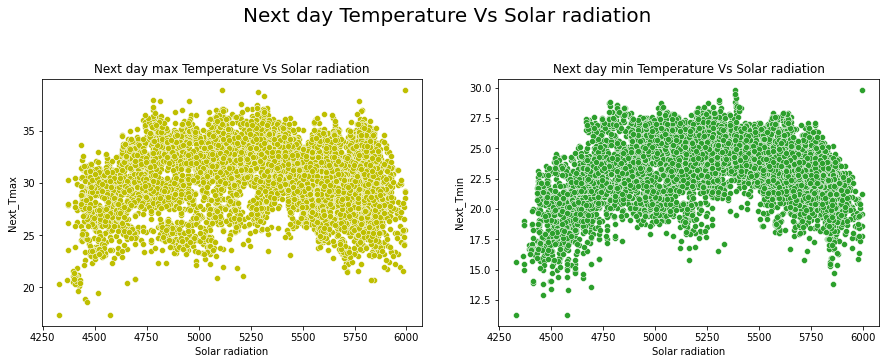

In [53]:
# Comparing Next day temperature and Solar radiation

plt.figure(figsize=(15,10))
plt.suptitle('Next day Temperature Vs Solar radiation',fontsize=20)

plt.subplot(2,2,1)
plt.title('Next day max Temperature Vs Solar radiation')
sns.scatterplot(x='Solar radiation',y='Next_Tmax',data=df,color="y")

plt.subplot(2,2,2)
plt.title('Next day min Temperature Vs Solar radiation')
sns.scatterplot(x='Solar radiation',y='Next_Tmin',data=df,color="tab:green")
plt.show()

The solar radiations does not seem to affect the Tmax and Tmin. By looking at the plot we can say that when the daily incoming solar radiations are in the range 4750 to 5300, the temperature is high.

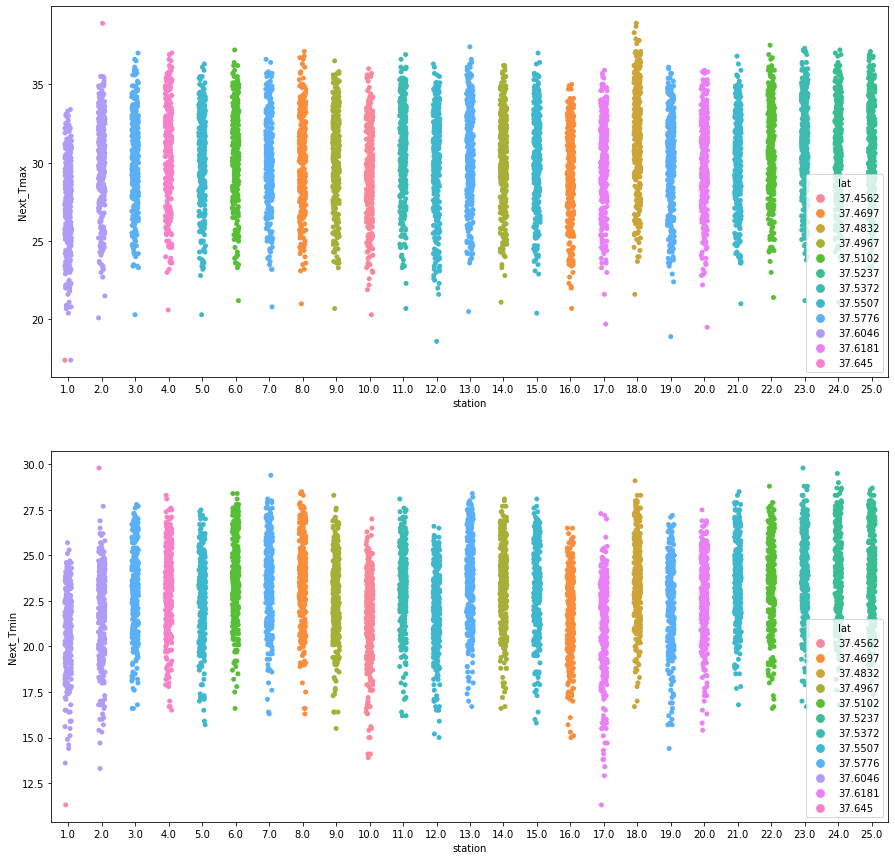

In [54]:
# Visualizing the relation between station and the target variables on the basis of latitude
plt.figure(figsize=(15,15))
plt.subplot(2,1,1)
sns.stripplot(df['station'],df["Next_Tmax"],data=df,hue=df["lat"])
plt.subplot(2,1,2)
sns.stripplot(df['station'],df["Next_Tmin"],data=df,hue=df["lat"])
plt.show()

* Each station is located on the particular latitude. There are atmost 3 stations on single latitude.
* As the latitude decreases in each station, the temperture seemd to be increases.

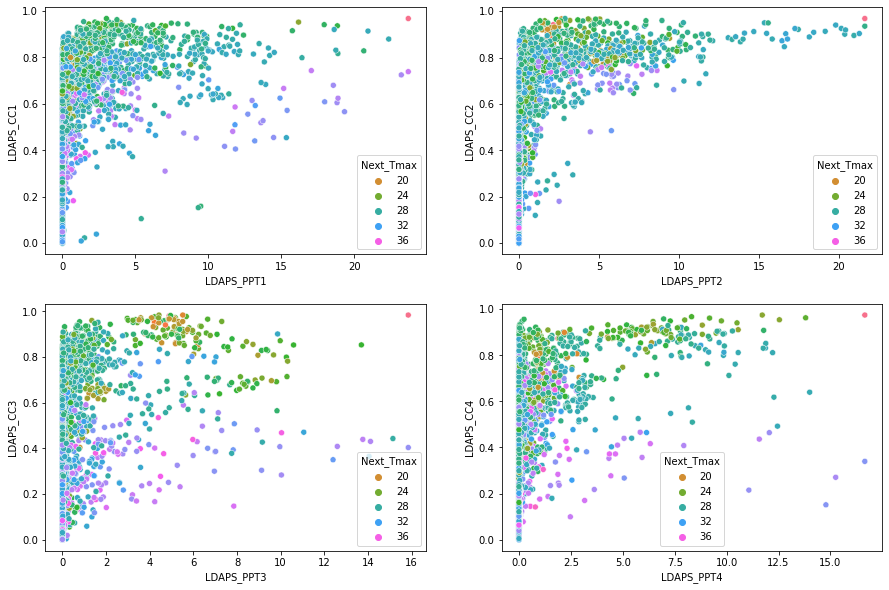

In [55]:
plt.figure(figsize=(15,10))

plt.subplot(2,2,1)
sns.scatterplot(x='LDAPS_PPT1',y='LDAPS_CC1',hue='Next_Tmax',data=df,palette="husl")

plt.subplot(2,2,2)
sns.scatterplot(x='LDAPS_PPT2',y='LDAPS_CC2',hue='Next_Tmax',data=df,palette="husl")

plt.subplot(2,2,3)
sns.scatterplot(x='LDAPS_PPT3',y='LDAPS_CC3',hue='Next_Tmax',data=df,palette="husl")

plt.subplot(2,2,4)
sns.scatterplot(x='LDAPS_PPT4',y='LDAPS_CC4',hue='Next_Tmax',data=df,palette="husl")
plt.show()

* In all the graphs the Next_Tmax is higher when the precipitation and cloud cover both have lower value.
* In the first split of cloud cover and precipitation , precipitation increases after the cloud cover value crosses 0.2 while this threshold increases to 0.5 in 2nd split after that it decreses for all the splits.
* We can observe the presence of outliers from the graph.

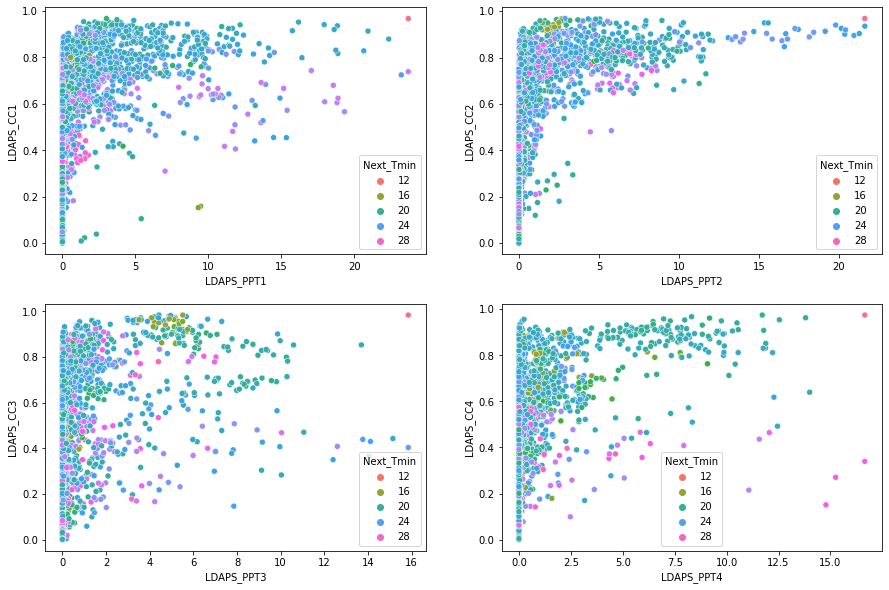

In [56]:
plt.figure(figsize=(15,10))

plt.subplot(2,2,1)
sns.scatterplot(x='LDAPS_PPT1',y='LDAPS_CC1',hue='Next_Tmin',data=df,palette="husl")

plt.subplot(2,2,2)
sns.scatterplot(x='LDAPS_PPT2',y='LDAPS_CC2',hue='Next_Tmin',data=df,palette="husl")

plt.subplot(2,2,3)
sns.scatterplot(x='LDAPS_PPT3',y='LDAPS_CC3',hue='Next_Tmin',data=df,palette="husl")

plt.subplot(2,2,4)
sns.scatterplot(x='LDAPS_PPT4',y='LDAPS_CC4',hue='Next_Tmin',data=df,palette="husl")
plt.show()

* Here also same thing happens that was happend in the case of Tmax. In all the graphs the Next_Tmax is higher when the precipitation and cloud cover both have lower value.
* In the first split of cloud cover and precipitation , precipitation increases after the cloud cover value crosses 0.2 while this threshold increases to 0.5 in 2nd split after that it decreses for all the splits.
* We can observe the presence of outliers from the graph.

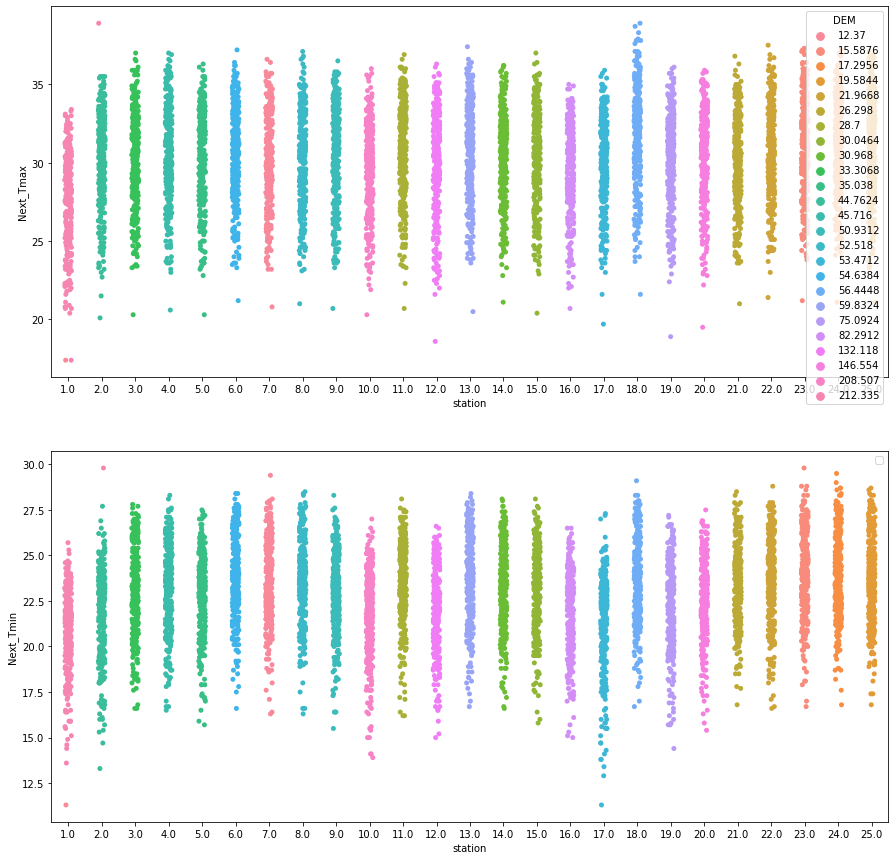

In [57]:
# Visualizing the relation between station and the target variables on the basis of longitude
plt.figure(figsize=(15,15))
plt.subplot(2,1,1)
sns.stripplot(df['station'],df["Next_Tmax"],data=df,hue=df["DEM"])
plt.subplot(2,1,2)
sns.stripplot(df['station'],df["Next_Tmin"],data=df,hue=df["DEM"])
plt.legend("")
plt.show()

* From the plot we can coclude that, each station belongs to a particular elevation and there is only one station belonging to particular elevation.
* The highest Tmax is noted at the station 18 which have the elevation 56.4448 and it is not lowest elevation. This indicates that elevation alone does not decide the temperature.

# Multivariate Analysis

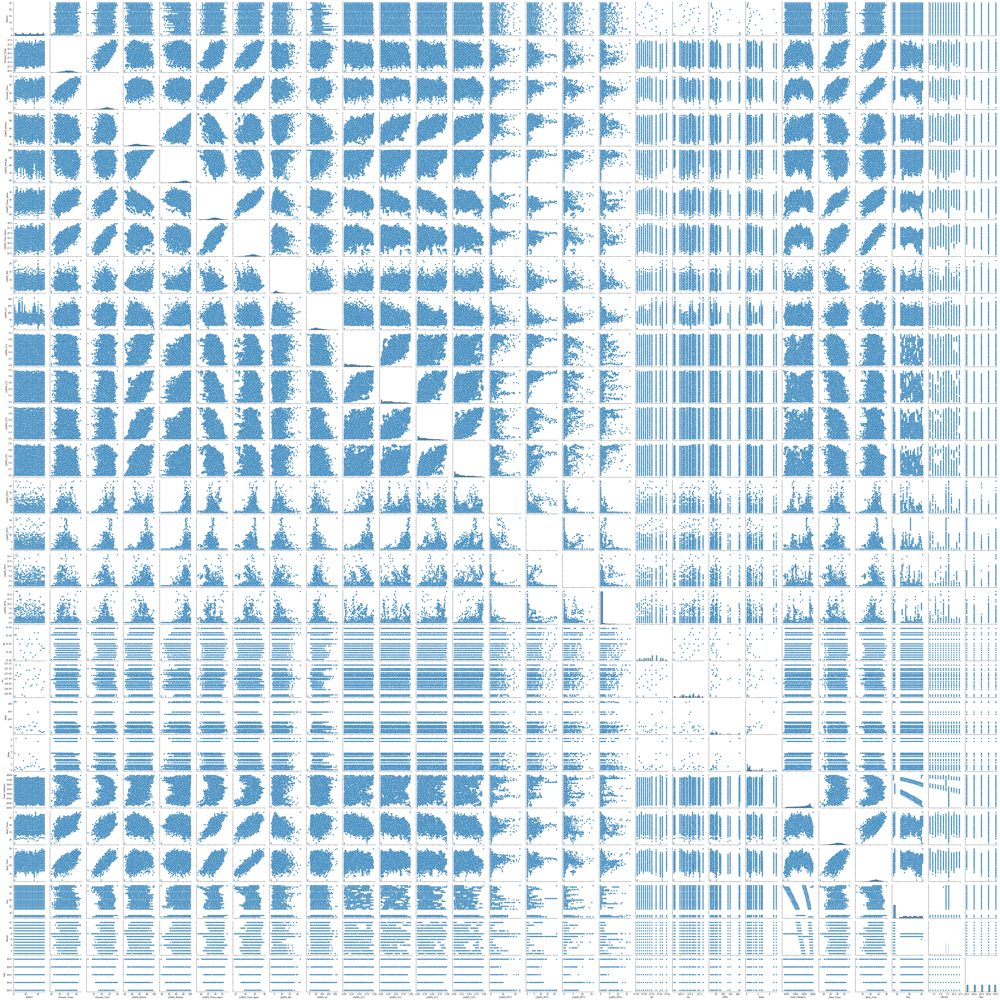

In [58]:
# Checking the pairwise relation between the features and label Next_Tmax.
sns.pairplot(df,palette="husl")

* The pairplot gives the pairwise relation between the features on the basis of the targets Next_Tmax. On the diagonal we can notice the distribution plots in the pairplots.
* We can notice most of the feature have strong linear relationship with each other and also we can observe the presence of outliers in many columns. We will indentify the outliers using boxplots.

# Checking for outliers

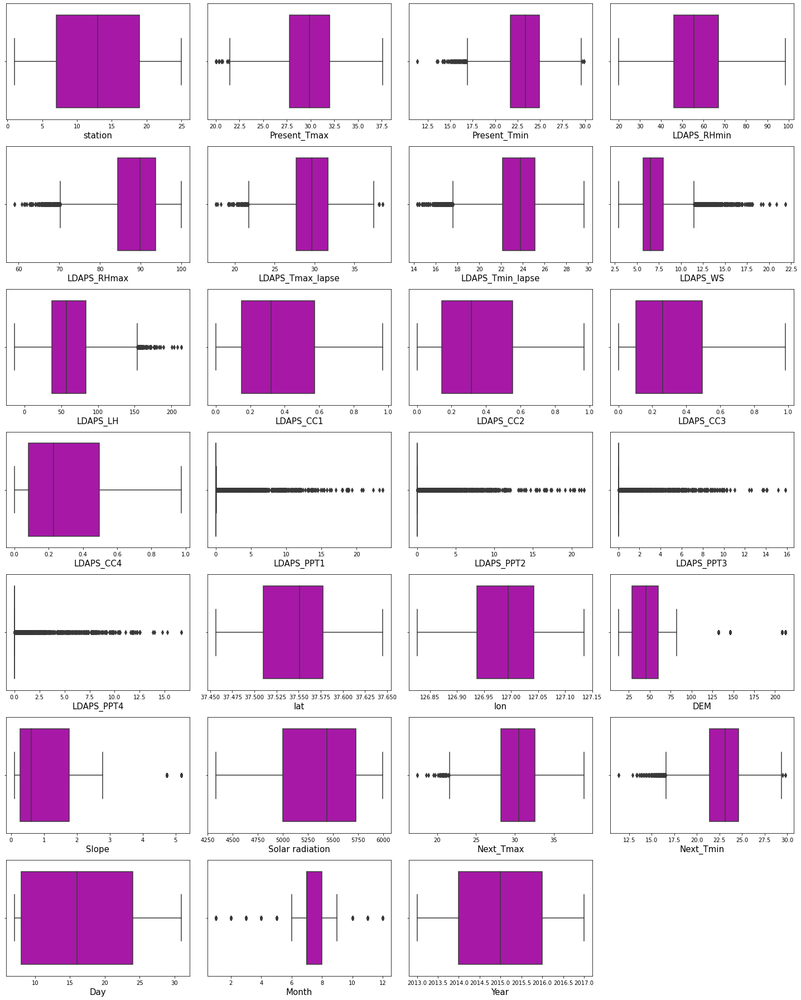

In [59]:
# Checking for outliers present in the dataset
plt.figure(figsize=(20,25),facecolor="white")
plotnumber=1
for col in df.columns:
    if plotnumber<=27:
        ax = plt.subplot(7,4,plotnumber)
        sns.boxplot(df[col],color='m')
        plt.xlabel(col,fontsize=15)
    plotnumber+=1
plt.tight_layout()

The outliers are present in the following outliers:
* Presnt_Tmax
* Present_Tmin
* LDAPS_RHmax
* LDAPS_Tmax_lapse
* LDAPS_Tmin_lapse
* LDAPS_WS
* LDAPS_LH
* LDAPS_PPT1
* LDAPS_PPT2
* LDAPS_PPT3
* LDAPS_PPT4
* DEM
* Slope
* Next_Tmax
* Next_Tmin
* Month

## Removing outliers

## Zscore method

In [60]:
# Features containing outliers
features = df[['Present_Tmax','Present_Tmin','LDAPS_RHmax','LDAPS_Tmax_lapse','LDAPS_Tmin_lapse','LDAPS_WS','LDAPS_LH','LDAPS_PPT1','LDAPS_PPT2','LDAPS_PPT3','LDAPS_PPT4','DEM','Slope','Month']]
from scipy.stats import zscore
z = np.abs(zscore(features))
z

array([[1.9049697 , 1.82070663, 0.7672715 , ..., 0.0375039 , 1.04312489,
        0.41069088],
       [1.39759012, 1.52938967, 2.33071228, ..., 0.65535023, 0.49983282,
        0.41069088],
       [1.61286208, 0.55144577, 0.98886827, ..., 0.49432225, 0.54843336,
        0.41069088],
       ...,
       [2.3570188 , 1.21731311, 1.37466166, ..., 2.77224286, 1.11500407,
        0.48297247],
       [1.1393078 , 0.07280486, 0.74785305, ..., 0.17226627, 0.22319144,
        0.0361408 ],
       [1.00400658, 1.34216324, 0.32788411, ..., 0.31515742, 0.54215762,
        2.27029918]])

In [61]:
# Creating new dataframe
new_df = df[(z<3).all(axis=1)]
new_df

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Day,Month,Year
5837,13.0,35.4,27.6,34.987228,82.896393,34.149833,25.226180,5.461130,58.780405,0.004022,0.007537,0.020811,0.092094,0.000000,0.000000,0.000000,0.000000,37.5776,127.083,59.8324,2.6865,4917.379883,34.7,25.8,16,8,2016
5995,21.0,33.9,26.9,34.832619,71.705269,34.592346,25.166330,6.745301,14.679706,0.021072,0.002549,0.118135,0.337243,0.000000,0.000000,0.000000,0.000000,37.5507,127.040,26.2980,0.5721,4723.027344,31.9,26.6,22,8,2016
4543,19.0,24.9,18.4,37.753532,92.758827,28.233194,20.850640,7.222731,37.695517,0.241559,0.212595,0.040632,0.036497,0.000000,0.000000,0.000000,0.000000,37.5776,126.938,75.0924,1.7678,4650.964355,29.8,20.1,26,8,2015
2500,1.0,24.4,20.3,41.471645,93.061089,29.951621,20.161316,8.372485,134.273138,0.015548,0.000000,0.182080,0.000409,0.002677,0.000000,0.000000,0.000000,37.6046,126.991,212.3350,2.7850,5388.140137,27.8,19.5,8,7,2014
779,5.0,30.0,24.4,57.116608,92.495697,30.784407,24.421258,4.087337,111.940126,0.180527,0.140732,0.113067,0.008820,0.000000,0.000000,0.000000,0.000000,37.5507,127.135,35.0380,0.5055,5414.678711,32.1,24.6,31,7,2013
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5505,6.0,33.8,24.9,40.814709,83.266594,35.278243,26.587176,5.352375,52.845979,0.284943,0.065606,0.083580,0.063233,0.000000,0.000000,0.000000,0.000000,37.5102,127.042,54.6384,0.1457,5328.801758,35.5,26.5,8,3,2016
57,8.0,27.8,23.2,54.792088,91.937553,28.764731,20.727513,9.053970,47.794772,0.276732,0.219182,0.030873,0.004855,0.000000,0.000000,0.000000,0.000000,37.4697,126.910,52.5180,1.5629,5852.468262,30.0,20.3,7,2,2013
2475,1.0,22.8,20.3,61.983395,98.228371,26.499361,21.034378,5.658450,77.778620,0.655144,0.567612,0.513970,0.161410,0.004397,0.127559,0.398209,0.000000,37.6046,126.991,212.3350,2.7850,5415.057617,24.8,20.2,8,6,2014
432,8.0,26.4,23.4,73.263000,93.741669,27.162298,24.438185,5.884680,25.986054,0.569781,0.618961,0.613701,0.299167,0.035559,0.098596,0.000000,0.000000,37.4697,126.910,52.5180,1.5629,5689.650879,28.5,23.9,17,7,2013


In [62]:
print(df.shape)
print(new_df.shape)

(7752, 27)
(6907, 27)


In [63]:
# Checking data loss
loss = (7752-6907)/7752*100
loss

10.900412796697626

Here we are losing more than 10% data. Lets check using IQR method.

## IQR(Inter Qunatile Range)

In [64]:
# 1st quantile
Q1 = features.quantile(0.25)

# 3rd quantile
Q3 = features.quantile(0.75)

# IQR
IQR = Q3-Q1

df1 = df[~((df<(Q1-1.5*IQR))|(df>(Q3+1.5*IQR))).any(axis=1)]

In [65]:
df1.shape

(2413, 27)

In [66]:
# Checking data loss
loss=(7752-2413)/7752*100
loss

68.87254901960785

By using both Zscore and IQR method we are losing more data. Its not suggestable to remove more than 10% of data as it may impact other variables.So we will keep the outliers as it is.

# Correlation

In [67]:
# Checking the correlation between features and label
cor = df.corr()
cor

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Day,Month,Year
station,1.000000,0.112806,0.132122,-0.066731,-0.166334,0.069363,0.105053,0.004353,-0.133693,0.006769,0.003223,0.000442,0.005849,-0.004990,-0.010555,-0.015051,-0.013033,-0.237438,-0.118574,-0.256095,-0.090413,-0.018787,0.108289,0.128713,-0.000730,-0.000169,-0.000582
Present_Tmax,0.112806,1.000000,0.618760,-0.204571,-0.300322,0.570129,0.624216,-0.123582,0.134251,-0.311805,-0.213791,-0.145577,-0.142683,-0.111129,-0.101377,-0.122044,-0.101178,-0.052615,0.009020,-0.187121,-0.105809,-0.025439,0.610348,0.622741,-0.143899,-0.001185,0.059665
Present_Tmin,0.132122,0.618760,1.000000,0.123143,-0.012754,0.464151,0.764227,-0.037708,-0.011276,0.084447,0.090263,-0.005466,-0.047714,0.109121,0.064829,-0.049005,-0.065647,-0.078475,-0.043461,-0.250275,-0.146339,0.053578,0.471806,0.796670,-0.108728,-0.003550,0.036987
LDAPS_RHmin,-0.066731,-0.204571,0.123143,1.000000,0.579032,-0.564580,0.089471,0.294271,-0.070848,0.613818,0.745443,0.689513,0.513878,0.262547,0.390824,0.240576,0.168555,0.087099,-0.076237,0.102115,0.123744,0.244080,-0.437898,0.095019,-0.065735,-0.053922,-0.001984
LDAPS_RHmax,-0.166334,-0.300322,-0.012754,0.579032,1.000000,-0.373334,-0.113914,0.134786,0.238183,0.436570,0.391256,0.226434,0.130008,0.267698,0.228398,0.134087,0.117376,0.195761,0.025662,0.177134,0.219557,0.148259,-0.281341,-0.070246,-0.012803,-0.039040,-0.142223
LDAPS_Tmax_lapse,0.069363,0.570129,0.464151,-0.564580,-0.373334,1.000000,0.653985,-0.311900,0.048004,-0.438439,-0.523619,-0.541197,-0.429374,-0.111016,-0.242033,-0.188063,-0.160235,-0.042093,0.090666,-0.178895,-0.162332,0.047971,0.827189,0.586868,-0.160495,-0.021745,0.015978
LDAPS_Tmin_lapse,0.105053,0.624216,0.764227,0.089471,-0.113914,0.653985,1.000000,-0.130245,-0.134906,0.010900,0.047725,-0.044233,-0.080587,0.037727,0.000588,-0.088791,-0.094855,-0.096252,-0.026700,-0.195445,-0.185839,0.159445,0.588206,0.881059,-0.177770,-0.026990,-0.004937
LDAPS_WS,0.004353,-0.123582,-0.037708,0.294271,0.134786,-0.311900,-0.130245,1.000000,0.007115,0.289356,0.261010,0.243402,0.221066,0.153213,0.192427,0.162173,0.144550,0.036646,-0.059448,0.190995,0.171577,0.122966,-0.345619,-0.098767,-0.028982,-0.082375,-0.110409
LDAPS_LH,-0.133693,0.134251,-0.011276,-0.070848,0.238183,0.048004,-0.134906,0.007115,1.000000,-0.147276,-0.264245,-0.245130,-0.172222,-0.012042,-0.077061,0.016483,0.020332,0.133203,0.025819,0.055126,0.086770,-0.046553,0.155608,-0.056906,-0.012227,-0.023536,0.057462
LDAPS_CC1,0.006769,-0.311805,0.084447,0.613818,0.436570,-0.438439,0.010900,0.289356,-0.147276,1.000000,0.779683,0.517368,0.360908,0.446128,0.389310,0.168695,0.091700,-0.008131,-0.006843,-0.014090,-0.020752,0.218309,-0.452541,-0.011028,-0.019928,-0.076224,-0.066300


This is the correlation between the dependent and independent variables. Lets visualize the correlation using heatmap.

<AxesSubplot:>

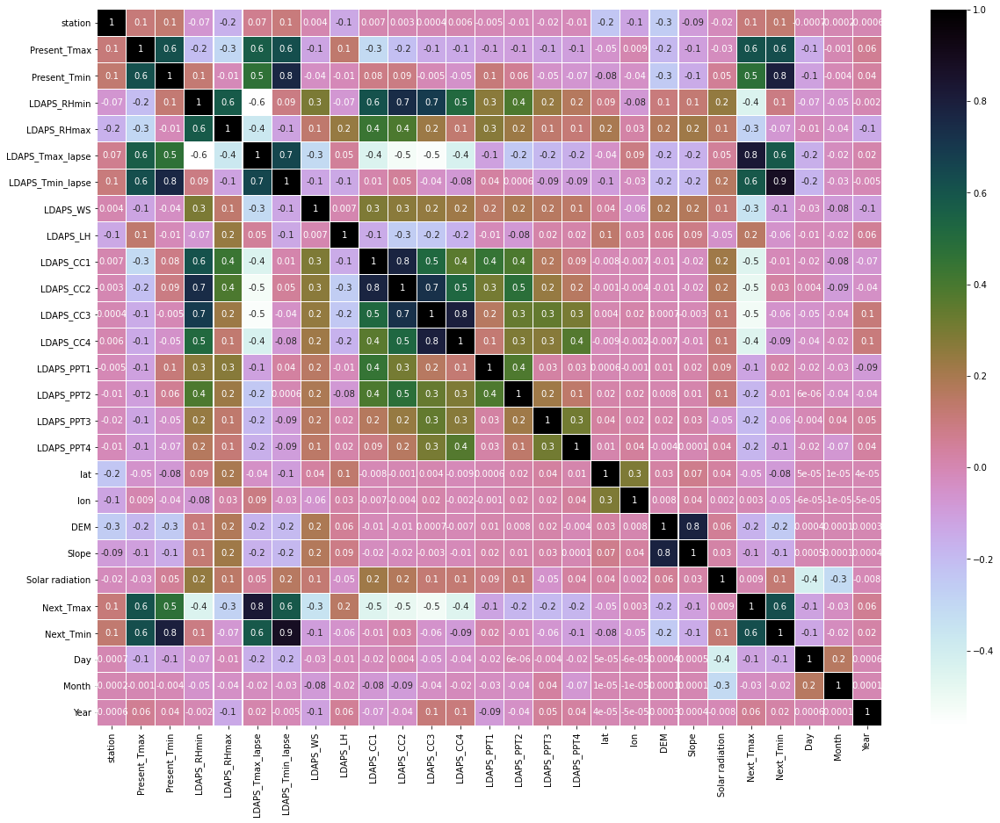

In [68]:
# Visualizing the correlation matrix 
plt.figure(figsize=(20,15))
sns.heatmap(df.corr(),linewidths=.1,fmt=".1g",annot=True,cmap="cubehelix_r")

This heatmap contains both positive and negative correlation.

### Correlation between Next_Tmax and features

* The label Next_Tmax is highly positively correlated with LDAPS_Tmax_lapse, LDAPS_Tmin_lapse, Present_Tmax, Present_Tmin and Next_Tmin.
* The label is negatively correlated with LDAPS_CC1, LDAPS_CC2, LDAPS_CC3, LDAPS_CC4, LDAPS_RHmax, LDAPS_RHmin, and LDAPS_WS.
* The features lon and Solar radiations have very less correlation with the target Next_Tmin.

### Correlation between Next_Tmin and features
* The label Next_Tmin is highly positively correlated with LDAPS_Tmin_lapse, Present_Tmin, LDAPS_Tmax_lapse, Present_Tmax and Next_Tmax.
* The label is negatively correlated with DEM, Slope and Day. 
* From the heat map we can observe that most of the features are highly correlated with each other which leads to a multicollinearity problem. We will check VIF values and then drop the columns containing VIF less than 5 to get rid of multicollinearity issue. 

# 1. Prediction for Next_Tmax

### Visualizing the correlation between label Next_Tmax and features

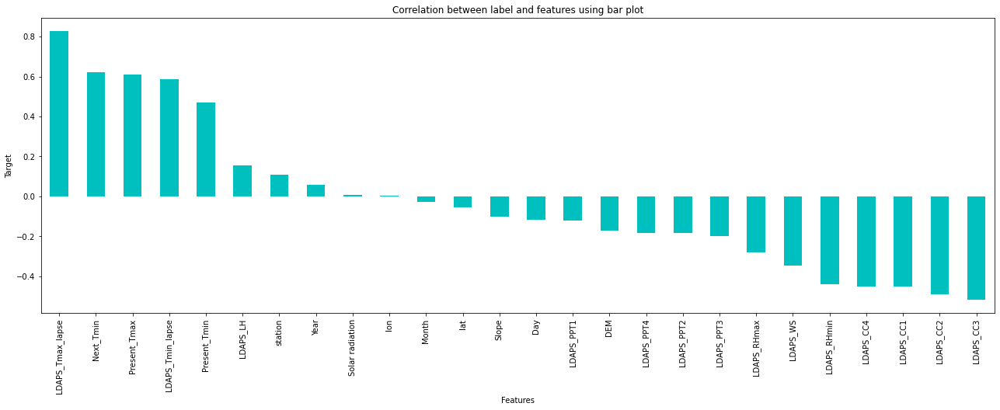

In [69]:
plt.figure(figsize=(22,7))
df.corr()['Next_Tmax'].sort_values(ascending=False).drop("Next_Tmax").plot(kind="bar",color='c')
plt.xlabel("Features",fontsize=10)
plt.ylabel("Target",fontsize=10)
plt.title("Correlation between label and features using bar plot")
plt.show()

The columns longitude and Solar radiation have very less correlation with the label. So we can drop these columns.

## Separating features and label

In [70]:
x = df.drop("Next_Tmax",axis=1)
y = df["Next_Tmax"]

In [71]:
x.shape

(7752, 26)

In [72]:
y.shape

(7752,)

## Checking for skewness

In [73]:
x.skew()

station             0.000182
Present_Tmax       -0.264137
Present_Tmin       -0.367538
LDAPS_RHmin         0.300220
LDAPS_RHmax        -0.860210
LDAPS_Tmax_lapse   -0.227880
LDAPS_Tmin_lapse   -0.584737
LDAPS_WS            1.584975
LDAPS_LH            0.678315
LDAPS_CC1           0.459458
LDAPS_CC2           0.472350
LDAPS_CC3           0.646670
LDAPS_CC4           0.673700
LDAPS_PPT1          5.395178
LDAPS_PPT2          5.776835
LDAPS_PPT3          6.458608
LDAPS_PPT4          6.826930
lat                 0.087062
lon                -0.285213
DEM                 1.723257
Slope               1.563020
Solar radiation    -0.511210
Next_Tmin          -0.404447
Day                 0.245283
Month              -0.705586
Year               -0.000365
dtype: float64

The following columns contains skewness
* LDAPS_RHmax
* LDAPS_Tmin_lapse
* LDAPS_WS
* LDAPS_LH
* LDAPS_CC3
* LDAPS_CC4
* LDAPS_PPT1
* LDAPS_PPT2
* LDAPS_PPT3
* LDAPS_PPT4
* DEM
* Slope
* Soalr radiation
* Month

## Removing skewness using yeo-johnson method

In [74]:
# Making the skew less than or equal to +0.5 and -0.5 for better prediction using yeo-johnson method
skew=['LDAPS_RHmax','LDAPS_Tmin_lapse','LDAPS_WS','LDAPS_LH','LDAPS_CC3','LDAPS_CC4','LDAPS_PPT1','LDAPS_PPT2','LDAPS_PPT3','LDAPS_PPT4','DEM','Slope','Solar radiation','Month']

from sklearn.preprocessing import PowerTransformer
scaler = PowerTransformer(method='yeo-johnson')
'''
parameters:
method = 'box-cox' or 'yeo-johnson'
'''

"\nparameters:\nmethod = 'box-cox' or 'yeo-johnson'\n"

In [75]:
x[skew] = scaler.fit_transform(x[skew].values)
x[skew].head()

,LDAPS_RHmax,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,DEM,Slope,Solar radiation,Month
5837,-0.905314,0.718935,-0.799231,0.001498,-1.439528,-0.818967,-0.557339,-0.519114,-0.492283,-0.444377,0.441360,1.284394,-1.046918,0.363879
5995,-1.889700,0.688758,0.056917,-1.658605,-0.789648,0.398806,-0.557339,-0.519114,-0.492283,-0.444377,-0.721547,-0.279532,-1.369905,0.363879
7479,1.098297,-0.038847,0.981503,0.008516,1.651402,0.987839,2.086883,0.163418,2.562258,-0.444377,-0.290442,-0.401730,-1.211408,0.363879
4543,0.563774,-1.157022,0.309347,-0.688473,-1.295999,-1.201016,-0.557339,-0.519114,-0.492283,-0.444377,0.724774,0.902752,-1.477589,0.363879
320,1.060590,-0.200258,-0.287489,-0.877448,1.823779,1.833298,2.197532,2.380505,2.483326,0.480299,-0.721547,-0.279532,1.021220,2.628001


In [76]:
x.skew()

station             0.000182
Present_Tmax       -0.264137
Present_Tmin       -0.367538
LDAPS_RHmin         0.300220
LDAPS_RHmax        -0.116481
LDAPS_Tmax_lapse   -0.227880
LDAPS_Tmin_lapse   -0.018120
LDAPS_WS            0.002449
LDAPS_LH            0.058865
LDAPS_CC1           0.459458
LDAPS_CC2           0.472350
LDAPS_CC3           0.089672
LDAPS_CC4           0.129826
LDAPS_PPT1          1.463941
LDAPS_PPT2          1.646417
LDAPS_PPT3          1.824919
LDAPS_PPT4          2.059400
lat                 0.087062
lon                -0.285213
DEM                 0.039456
Slope               0.233968
Solar radiation    -0.176636
Next_Tmin          -0.404447
Day                 0.245283
Month               0.043780
Year               -0.000365
dtype: float64

The skewness has been removed from all the columns except LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3 and LDAPS_PPT1.
Lets remove the skewness from these columns using log transformation.

In [77]:
# Removing skewness usinf log transformation
x['LDAPS_PPT1'] = np.log1p(x['LDAPS_PPT1'])
x['LDAPS_PPT2'] = np.log1p(x['LDAPS_PPT2'])
x['LDAPS_PPT3'] = np.log1p(x['LDAPS_PPT3'])
x['LDAPS_PPT4'] = np.log1p(x['LDAPS_PPT4'])

In [78]:
x.skew()

station             0.000182
Present_Tmax       -0.264137
Present_Tmin       -0.367538
LDAPS_RHmin         0.300220
LDAPS_RHmax        -0.116481
LDAPS_Tmax_lapse   -0.227880
LDAPS_Tmin_lapse   -0.018120
LDAPS_WS            0.002449
LDAPS_LH            0.058865
LDAPS_CC1           0.459458
LDAPS_CC2           0.472350
LDAPS_CC3           0.089672
LDAPS_CC4           0.129826
LDAPS_PPT1          1.248702
LDAPS_PPT2          1.418959
LDAPS_PPT3          1.554603
LDAPS_PPT4          1.823710
lat                 0.087062
lon                -0.285213
DEM                 0.039456
Slope               0.233968
Solar radiation    -0.176636
Next_Tmin          -0.404447
Day                 0.245283
Month               0.043780
Year               -0.000365
dtype: float64

Tried removing skewness from LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3 and LDAPS_PPT4 using yeo-johnson and log transformation methods but the skewness has not been removed but it got reduced. Lets check the distribution afetr removing skewness

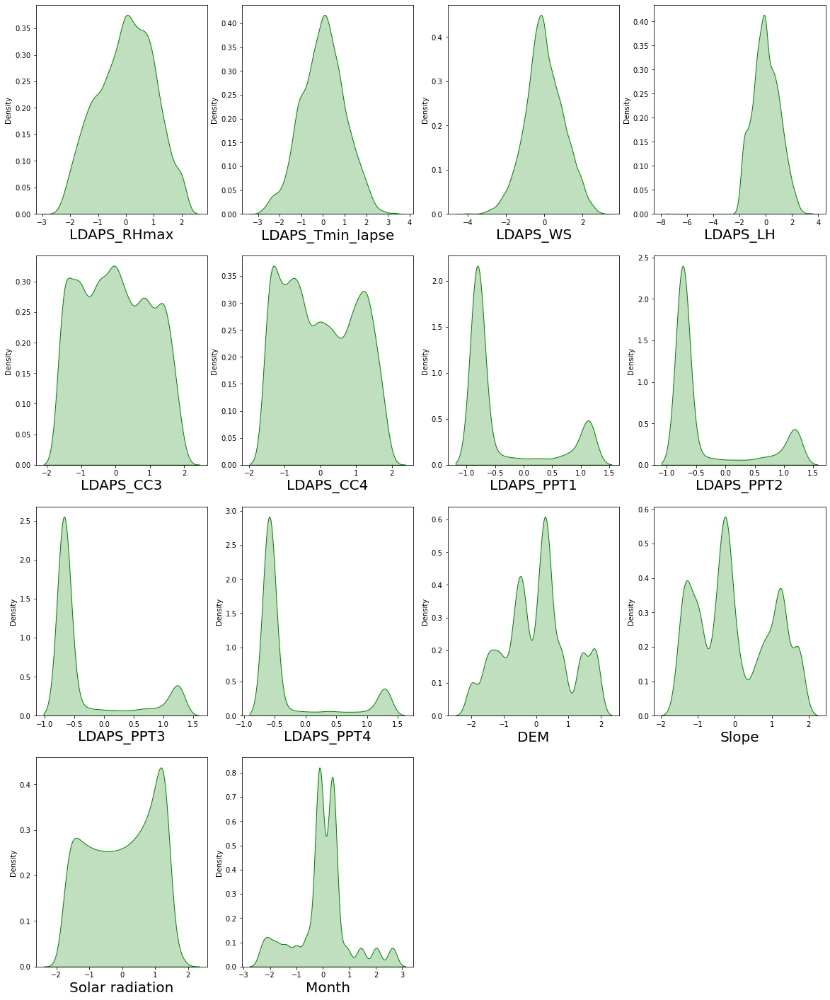

In [79]:
# After removing skewness let's check how the data has been distributed in each column.

plt.figure(figsize=(20,25), facecolor='white')
plotnumber = 1

for column in x[skew]:
    if plotnumber<=14:
        ax = plt.subplot(4,4,plotnumber)
        sns.distplot(x[column],color='g',kde_kws={"shade": True},hist=False)
        plt.xlabel(column,fontsize=20)
    plotnumber+=1
plt.show()

## Feature Scaling using MinMaxScaler

In [80]:
from sklearn.preprocessing import MinMaxScaler

mms=MinMaxScaler()
x = pd.DataFrame(mms.fit_transform(x), columns=x.columns)
x

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmin,Day,Month,Year
0,0.500000,0.875000,0.876344,0.192970,0.336495,0.790010,0.581655,0.466086,0.683566,0.004158,0.007783,0.044335,0.196588,0.000000,0.000000,0.000000,0.000000,0.643008,0.831715,0.635190,0.857810,0.224850,0.783784,0.375000,0.537778,0.75
1,0.833333,0.789773,0.838710,0.191006,0.122467,0.811165,0.576788,0.585667,0.531295,0.021785,0.002632,0.227110,0.557767,0.000000,0.000000,0.000000,0.000000,0.500530,0.692557,0.330774,0.372033,0.138409,0.827027,0.625000,0.537778,0.75
2,0.166667,0.284091,0.569892,0.824880,0.772128,0.488643,0.459445,0.714807,0.684210,0.794733,0.628571,0.913639,0.732468,0.981993,0.453022,0.999998,0.000000,0.500530,1.000000,0.443625,0.334076,0.180828,0.648649,0.541667,0.537778,1.00
3,0.750000,0.278409,0.381720,0.228107,0.655910,0.507151,0.279114,0.620925,0.620279,0.249731,0.219543,0.084701,0.083276,0.000000,0.000000,0.000000,0.000000,0.643008,0.362460,0.709380,0.739267,0.109590,0.475676,0.791667,0.537778,0.50
4,0.833333,0.267045,0.655914,0.906027,0.763929,0.392902,0.433414,0.537563,0.602946,0.920424,0.978341,0.962118,0.983223,0.999800,0.999969,0.988497,0.516917,0.500530,0.692557,0.330774,0.372033,0.778346,0.605405,0.000000,1.000000,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,0.208333,0.784091,0.731183,0.266989,0.345944,0.843956,0.698164,0.453828,0.666822,0.294583,0.067750,0.166461,0.139665,0.000000,0.000000,0.000000,0.000000,0.286017,0.699029,0.604369,0.051153,0.455595,0.821622,0.041667,0.110595,0.75
7748,0.291667,0.443182,0.639785,0.444524,0.623351,0.532563,0.272078,0.726109,0.651973,0.286094,0.226345,0.065047,0.011526,0.000000,0.000000,0.000000,0.000000,0.071504,0.271845,0.590723,0.701013,0.864260,0.486486,0.000000,0.050037,0.00
7749,0.000000,0.159091,0.483871,0.535866,0.905669,0.424262,0.289757,0.487342,0.733126,0.677307,0.586162,0.704111,0.318681,0.050165,0.654758,0.955648,0.000000,0.786017,0.533981,1.000000,0.867054,0.513290,0.481081,0.041667,0.344567,0.25
7750,0.291667,0.363636,0.650538,0.679135,0.696486,0.455955,0.519268,0.510268,0.578955,0.589056,0.639190,0.783307,0.512979,0.292650,0.586888,0.000000,0.000000,0.071504,0.271845,0.590723,0.701013,0.721526,0.681081,0.416667,0.437757,0.00


## Checking for Multicolinearity

In [81]:
# Finding variance inflation factor in each scaled column 

from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif["Features"] = x.columns
vif

,VIF values,Features
0,4.534444,station
1,34.446294,Present_Tmax
2,87.543434,Present_Tmin
3,46.295155,LDAPS_RHmin
4,18.905266,LDAPS_RHmax
5,91.176599,LDAPS_Tmax_lapse
6,65.498860,LDAPS_Tmin_lapse
7,20.705873,LDAPS_WS
8,64.000647,LDAPS_LH
9,16.577902,LDAPS_CC1


The column Next_Tmin has VIF value greater than 10, we will remove this to overcome with the issue of multicollinearity. After dropping the column will check VIF again, if we find the value above 10 then we will remove that column having high VIF. This process will continue until we get the VIF value less than 10.

In [82]:
# Dropping Next_Tmin column
x.drop("Next_Tmin",axis=1,inplace=True)

In [83]:
# Checking variance inflation factor again

vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif["Features"] = x.columns
vif

,VIF values,Features
0,4.533614,station
1,33.900778,Present_Tmax
2,77.682427,Present_Tmin
3,44.968575,LDAPS_RHmin
4,18.727293,LDAPS_RHmax
5,85.765722,LDAPS_Tmax_lapse
6,53.772203,LDAPS_Tmin_lapse
7,20.433138,LDAPS_WS
8,63.903843,LDAPS_LH
9,16.576953,LDAPS_CC1


The column LDAPS_Tmax_lapse has High VIF value compare to other columns. Let's drop it.

In [84]:
# Dropping LDAPS_Tmax_lapse column
x.drop("LDAPS_Tmax_lapse",axis=1,inplace=True)

In [85]:
# Checking variance inflation factor again

vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif["Features"] = x.columns
vif

,VIF values,Features
0,4.447999,station
1,33.653666,Present_Tmax
2,74.306403,Present_Tmin
3,32.212084,LDAPS_RHmin
4,18.555118,LDAPS_RHmax
5,29.566169,LDAPS_Tmin_lapse
6,20.395703,LDAPS_WS
7,50.121126,LDAPS_LH
8,16.465919,LDAPS_CC1
9,18.014258,LDAPS_CC2


After removing two columns also we are getting VIF value high in Present_Tmin. We will drop this column.

In [86]:
# Dropping Present_Tmin column
x.drop("Present_Tmin",axis=1,inplace=True)

In [87]:
# Checking variance inflation factor again

vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif["Features"] = x.columns
vif

,VIF values,Features
0,4.421988,station
1,29.222872,Present_Tmax
2,32.189515,LDAPS_RHmin
3,18.107927,LDAPS_RHmax
4,20.147684,LDAPS_Tmin_lapse
5,19.810068,LDAPS_WS
6,47.998075,LDAPS_LH
7,16.225436,LDAPS_CC1
8,18.013619,LDAPS_CC2
9,17.752356,LDAPS_CC3


The VIF is high in LDAPS_LH, remove that column.

In [88]:
# Dropping LDAPS_LH column
x.drop("LDAPS_LH",axis=1,inplace=True)

In [89]:
# Checking variance inflation factor again

vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif["Features"] = x.columns
vif

,VIF values,Features
0,4.357518,station
1,22.473196,Present_Tmax
2,31.958555,LDAPS_RHmin
3,14.974834,LDAPS_RHmax
4,19.624729,LDAPS_Tmin_lapse
5,17.891237,LDAPS_WS
6,15.846357,LDAPS_CC1
7,17.445512,LDAPS_CC2
8,17.642834,LDAPS_CC3
9,9.838177,LDAPS_CC4


The vif values are high in LDAPS_RHmin, Present_Tmax.

In [90]:
# Dropping LDAPS_RHmin and Present_Tmax column
x.drop(["Present_Tmax","LDAPS_RHmin"],axis=1,inplace=True)

In [91]:
# Checking variance inflation factor again

vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif["Features"] = x.columns
vif

,VIF values,Features
0,4.248094,station
1,10.524274,LDAPS_RHmax
2,8.439096,LDAPS_Tmin_lapse
3,16.842826,LDAPS_WS
4,14.791893,LDAPS_CC1
5,16.359842,LDAPS_CC2
6,15.782400,LDAPS_CC3
7,9.814399,LDAPS_CC4
8,3.866105,LDAPS_PPT1
9,3.328475,LDAPS_PPT2


In [92]:
# Removing the column LDAPS_WS and LDAPS_CC2 which has VIF greater than 10.
x.drop(["LDAPS_WS","LDAPS_CC2"],axis=1,inplace=True)

In [93]:
# Checking variance inflation factor again

vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif["Features"] = x.columns
vif

,VIF values,Features
0,3.965584,station
1,10.319921,LDAPS_RHmax
2,7.766354,LDAPS_Tmin_lapse
3,10.151356,LDAPS_CC1
4,12.983722,LDAPS_CC3
5,9.794644,LDAPS_CC4
6,3.557485,LDAPS_PPT1
7,2.573359,LDAPS_PPT2
8,2.382979,LDAPS_PPT3
9,2.165459,LDAPS_PPT4


In [94]:
# Removing the column DEM and LDAPS_CC3 which has VIF greater than 10.
x.drop(["DEM","LDAPS_CC3"],axis=1,inplace=True)

In [95]:
# Checking variance inflation factor again

vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif["Features"] = x.columns
vif

,VIF values,Features
0,3.678370,station
1,10.172606,LDAPS_RHmax
2,7.676324,LDAPS_Tmin_lapse
3,9.137945,LDAPS_CC1
4,5.279940,LDAPS_CC4
5,3.444979,LDAPS_PPT1
6,2.554055,LDAPS_PPT2
7,2.126760,LDAPS_PPT3
8,2.152462,LDAPS_PPT4
9,4.879320,lat


Finally we are getting VIF vakues less than 10 in all the columns and so multicolinearity problem has been resolved.

# Modeling

## Finding best random state

In [96]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

In [97]:
from sklearn.ensemble import RandomForestRegressor
maxAccu=0
maxRS=0
for i in range(1,200):
    x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.30, random_state=i)
    mod = RandomForestRegressor()
    mod.fit(x_train, y_train)
    pred = mod.predict(x_test)
    acc=r2_score(y_test, pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print("Maximum r2 score is ",maxAccu," on Random_state ",maxRS)

Maximum r2 score is  0.9128585375806612  on Random_state  158


### Creating new train test split

In [98]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.30,random_state=maxRS)

## Regression Algorithms

In [99]:
from sklearn.ensemble import RandomForestRegressor,ExtraTreesRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor as KNN
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import BaggingRegressor
import xgboost as xgb
from sklearn.metrics import classification_report
from sklearn.model_selection import cross_val_score
from sklearn import metrics

R2_score: 0.9118384693434575
MAE: 0.6984955160045303
MSE: 0.8646997438383879
RSME: 0.9298923291641823


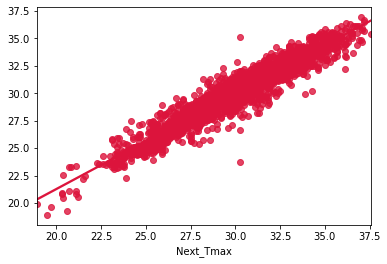

In [100]:
# Checking R2 score for RandomForestRegressor
RFR = RandomForestRegressor()
RFR.fit(x_train,y_train)
predRFR = RFR.predict(x_test)
print("R2_score:",r2_score(y_test,predRFR))
print("MAE:",metrics.mean_absolute_error(y_test,predRFR))
print("MSE:",metrics.mean_squared_error(y_test,predRFR))
print("RSME:",np.sqrt(metrics.mean_squared_error(y_test,predRFR)))

# Visualizing the predicted values
sns.regplot(y_test,predRFR,color="crimson")
plt.show()

The predicted R2 score using RandomForestRegressor is 91.18%.

## Decision Tree Regressor

R2_score: 0.7968137238012774
MAE: 0.9808578417049979
MSE: 1.9928773884947628
RSME: 1.4116930928834224


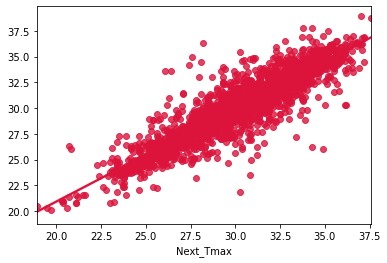

In [101]:
# Checking R2 score for DecisionTreeRegressor
DTR = DecisionTreeRegressor()
DTR.fit(x_train,y_train)
predDTR = DTR.predict(x_test)
print("R2_score:",r2_score(y_test,predDTR))
print("MAE:",metrics.mean_absolute_error(y_test,predDTR))
print("MSE:",metrics.mean_squared_error(y_test,predDTR))
print("RSME:",np.sqrt(metrics.mean_squared_error(y_test,predDTR)))

# Visualizing the predicted values
sns.regplot(y_test,predDTR,color="crimson")
plt.show()

The predicted R2 score using DecisionTreeRegressor is 79.68%.

## GradientBoostingRegressor

R2_score: 0.8089966355052728
MAE: 1.0779507101163428
MSE: 1.8733858080832242
RSME: 1.368716847300136


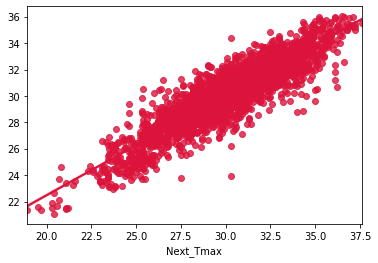

In [102]:
# Checking R2 score for GradientBoostingRegressor
GB = GradientBoostingRegressor()
GB.fit(x_train,y_train)
predGB = GB.predict(x_test)
print("R2_score:",r2_score(y_test,predGB))
print("MAE:",metrics.mean_absolute_error(y_test,predGB))
print("MSE:",metrics.mean_squared_error(y_test,predGB))
print("RSME:",np.sqrt(metrics.mean_squared_error(y_test,predGB)))

# Visualizing the predicted values
sns.regplot(y_test,predGB,color="crimson")
plt.show()

The predicted R2 score using GradientBoostingRegressor is 80.89%.

## BaggingRegressor

R2_score: 0.8944952594142981
MAE: 0.7694378810519608
MSE: 1.0348041995051473
RSME: 1.0172532622238906


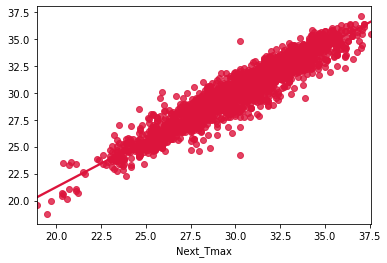

In [103]:
# Checking R2 score for BaggingRegressor
BR = BaggingRegressor()
BR.fit(x_train,y_train)
predBR = BR.predict(x_test)
print("R2_score:",r2_score(y_test,predBR))
print("MAE:",metrics.mean_absolute_error(y_test,predBR))
print("MSE:",metrics.mean_squared_error(y_test,predBR))
print("RSME:",np.sqrt(metrics.mean_squared_error(y_test,predBR)))

# Visualizing the predicted values
sns.regplot(y_test,predBR,color="crimson")
plt.show()

The predicted R2 score using BaggingRegressor is 89.44%.

## XGBRegressor

R2_score: 0.9149158374063583
MAE: 0.6994062151461967
MSE: 0.8345165181630828
RSME: 0.9135187563280147


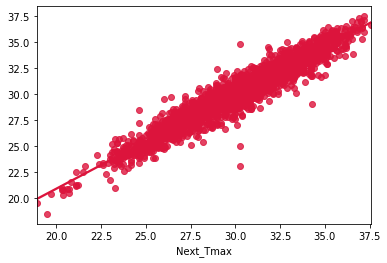

In [104]:
# Checking R2 score for XGB Regressor
from xgboost import XGBRegressor as xgb

XGB=xgb()
XGB.fit(x_train,y_train)
predXGB = XGB.predict(x_test)
print("R2_score:",r2_score(y_test,predXGB))
print("MAE:",metrics.mean_absolute_error(y_test,predXGB))
print("MSE:",metrics.mean_squared_error(y_test,predXGB))
print("RSME:",np.sqrt(metrics.mean_squared_error(y_test,predXGB)))

# Visualizing the predicted values
sns.regplot(y_test,predXGB,color="crimson")
plt.show()

The predicted R2 score using XGBRegressor is 91.49%.

R2_score: 0.9213776064596054
MAE: 0.6499997723775418
MSE: 0.7711386479800743
RSME: 0.8781450039600944


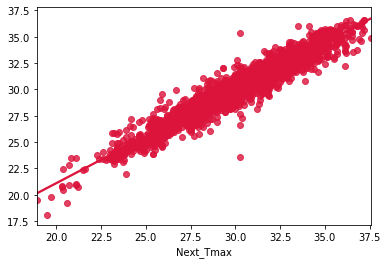

In [105]:
# Checking R2 score for ExtraTreesRegressor
ET = ExtraTreesRegressor()
ET.fit(x_train,y_train)
predET = ET.predict(x_test)
print("R2_score:",r2_score(y_test,predET))
print("MAE:",metrics.mean_absolute_error(y_test,predET))
print("MSE:",metrics.mean_squared_error(y_test,predET))
print("RSME:",np.sqrt(metrics.mean_squared_error(y_test,predET)))

# Visualizing the predicted values
sns.regplot(y_test,predET,color="crimson")
plt.show()

The predicted R2 score using ExtraTreesRegressor is 92.13%.

## Checking Cross Validation score

In [106]:
from sklearn.model_selection import cross_val_score

In [107]:
# Checking cv score for Random Forest Regressor
score=cross_val_score(RFR,x,y,cv=5)
print(score)
print("cross validation score:  ",score.mean())
print("Difference between R2 score and cross validation score is - ",r2_score(y_test,predRFR)-abs(score.mean()))

[0.91275103 0.90730974 0.9076626  0.89510228 0.90845177]
cross validation score:   0.9062554860098165
Difference between R2 score and cross validation score is -  0.005582983333640934


In [108]:
# Checking cv score for Decision Tree Regressor
score=cross_val_score(DTR,x,y,cv=5)
print(score)
print("cross validation score:  ",score.mean())
print("Difference between R2 score and cross validation score is - ",r2_score(y_test,predDTR)-abs(score.mean()))

[0.78604792 0.80984794 0.79245023 0.77028417 0.76537901]
cross validation score:   0.7848018521620472
Difference between R2 score and cross validation score is -  0.01201187163923012


In [109]:
# Checking cv score for Gradient Boosting Regressor
score=cross_val_score(GB,x,y,cv=5)
print(score)
print("cross validation score:  ",score.mean())
print("Difference between R2 score and cross validation score is - ",r2_score(y_test,predGB)-abs(score.mean()))

[0.8038068  0.80620984 0.80840573 0.77670162 0.79267863]
cross validation score:   0.7975605255678857
Difference between R2 score and cross validation score is -  0.011436109937387084


In [110]:
# Checking cv score for Bagging Regressor
score=cross_val_score(BR,x,y,cv=5)
print(score)
print("cross validation score:  ",score.mean())
print("Difference between R2 score and cross validation score is - ",r2_score(y_test,predBR)-abs(score.mean()))

[0.90271614 0.89793994 0.89049246 0.88298331 0.89212811]
cross validation score:   0.8932519930126557
Difference between R2 score and cross validation score is -  0.0012432664016424066


In [111]:
# Checking cv score for XGBRegressor
score=cross_val_score(XGB,x,y,cv=5)
print(score)
print("cross validation score:  ",score.mean())
print("Difference between R2 score and cross validation score is - ",r2_score(y_test,predXGB)-abs(score.mean()))

[0.91869504 0.91480428 0.91423968 0.89827203 0.91629168]
cross validation score:   0.9124605413472482
Difference between R2 score and cross validation score is -  0.0024552960591101014


In [112]:
# Checking cv score for ExtraTreesRegressor
score=cross_val_score(ET,x,y,cv=5)
print(score)
print("cross validation score:  ",score.mean())
print("Difference between R2 score and cross validation score is - ",r2_score(y_test,predET)-abs(score.mean()))

[0.91978647 0.91863379 0.916018   0.90556876 0.92144389]
cross validation score:   0.9162901811723991
Difference between R2 score and cross validation score is -  0.005087425287206293


From the differences between the R2 score and Cross Validation Score we can conclude that XGB Regressor as our best fitting model. We will perform Hyper parameter tuning on the best model.

# Hyper parameter tuning

In [113]:
from sklearn.model_selection import GridSearchCV

In [114]:
#XGB Regressor

parameters = {'n_estimators' : [50,100,150,200],
              'learning_rate':np.arange(0.05,0.5,0.05),
              'gamma' : np.arange(0,0.5,0.1),
              'max_depth' : [4, 6, 8,10]}

In [115]:
GCV=GridSearchCV(xgb(),parameters,cv=5)

In [117]:
GCV.fit(x_train,y_train)

GridSearchCV(cv=5,
             estimator=XGBRegressor(base_score=None, booster=None,
                                    colsample_bylevel=None,
                                    colsample_bynode=None,
                                    colsample_bytree=None, gamma=None,
                                    gpu_id=None, importance_type='gain',
                                    interaction_constraints=None,
                                    learning_rate=None, max_delta_step=None,
                                    max_depth=None, min_child_weight=None,
                                    missing=nan, monotone_constraints=None,
                                    n_estimators=100, n_jobs=None,
                                    num_parallel_tree=None, random_state=None,
                                    reg_alpha=None, reg_lambda=None,
                                    scale_pos_weight=None, subsample=None,
                                    tree_method=None, validate_para

In [118]:
GCV.best_params_

{'gamma': 0.30000000000000004,
 'learning_rate': 0.1,
 'max_depth': 8,
 'n_estimators': 200}

R2_Score: 92.2913153599318
RMSE value: 0.8695273441266996
MAE: 0.6639544312336889
MSE: 0.756077802184032


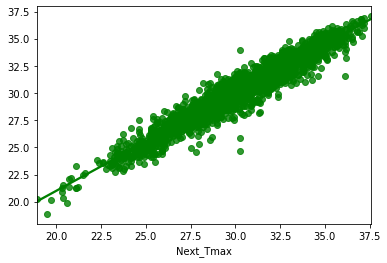

In [120]:
Final_model1 = xgb(gamma=0.30000000000000004, learning_rate=0.1, max_depth=8, n_estimators=200)
Final_model1.fit(x_train, y_train)
pred = Final_model1.predict(x_test)
print('R2_Score:',r2_score(y_test,pred)*100)
print("RMSE value:",np.sqrt(metrics.mean_squared_error(y_test, pred)))
print('MAE:',metrics.mean_absolute_error(y_test, pred))
print('MSE:',metrics.mean_squared_error(y_test, pred))

# Visualizing the predicted values
sns.regplot(y_test,pred,color="g")
plt.show()

After hyper parameter tuning our best model accuracy increased and giving 92.29% which is very good.

# Saving the model

In [121]:
# SAving the model using .pkl
import joblib
joblib.dump(Final_model1,"Temperature_Forecast_Next_Tmax.pkl")

['Temperature_Forecast_Next_Tmax.pkl']

## Predicting the saved model

In [122]:
# Loading the saved model
Model = joblib.load("Temperature_Forecast_Next_Tmax.pkl")

# prediction
a = np.array(y_test)
predicted = np.array(Model.predict(x_test))
df_com = pd.DataFrame({"Original":a,"Predicted":predicted},index= range(len(a)))
df_com

,Original,Predicted
0,31.8,31.502939
1,33.2,33.083984
2,30.3,30.229916
3,32.5,31.661028
4,26.3,26.827938
...,...,...
2321,30.5,31.292021
2322,35.4,35.779881
2323,20.7,21.397026
2324,32.1,32.965687


# 2. Prediction for Next_Tmin

## Visualizing the correlation between Next_Tmin and features

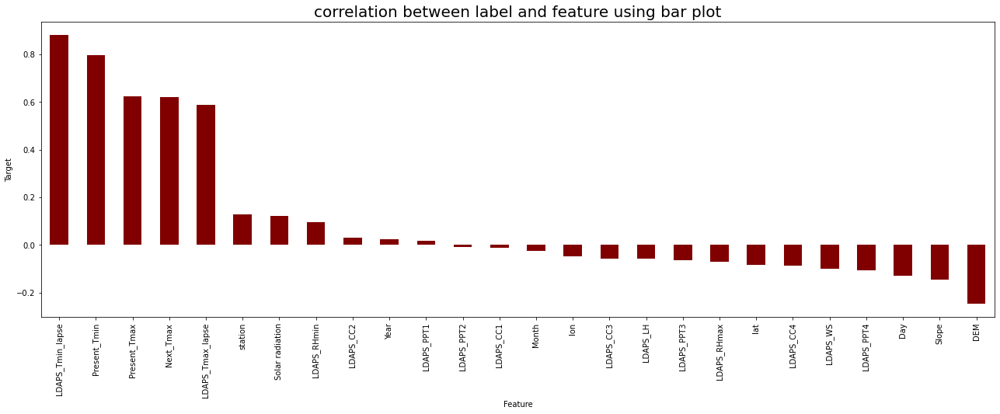

In [123]:
plt.figure(figsize=(22,7))
df.corr()['Next_Tmin'].sort_values(ascending=False).drop(['Next_Tmin']).plot(kind='bar',color='maroon')
plt.xlabel('Feature',fontsize=10)
plt.ylabel('Target',fontsize=10)
plt.title('correlation between label and feature using bar plot',fontsize=20)
plt.show()

## Separating features and label

In [124]:
X = df.drop("Next_Tmin",axis=1)
Y = df["Next_Tmin"]

In [125]:
X.shape

(7752, 26)

In [126]:
Y.shape

(7752,)

## Checking the skewness

In [127]:
X.skew()

station             0.000182
Present_Tmax       -0.264137
Present_Tmin       -0.367538
LDAPS_RHmin         0.300220
LDAPS_RHmax        -0.860210
LDAPS_Tmax_lapse   -0.227880
LDAPS_Tmin_lapse   -0.584737
LDAPS_WS            1.584975
LDAPS_LH            0.678315
LDAPS_CC1           0.459458
LDAPS_CC2           0.472350
LDAPS_CC3           0.646670
LDAPS_CC4           0.673700
LDAPS_PPT1          5.395178
LDAPS_PPT2          5.776835
LDAPS_PPT3          6.458608
LDAPS_PPT4          6.826930
lat                 0.087062
lon                -0.285213
DEM                 1.723257
Slope               1.563020
Solar radiation    -0.511210
Next_Tmax          -0.340200
Day                 0.245283
Month              -0.705586
Year               -0.000365
dtype: float64

The following columns contains skewness greater than +0.5 and -0.5.
* LDAPS_RHmax
* LDAPS_Tmin_lapse
* LDAPS_WS
* LDAPS_LH
* LDAPS_CC3
* LDAPS_CC4
* LDAPS_PPT1
* LDAPS_PPT2
* LDAPS_PPT3
* LDAPS_PPT4
* DEM
* Slope
* Solar radiation
* Month

## Removing skewness using yeo-johnson method

In [128]:
# Making the skew less than or equal to +0.5 and -0.5 for better prediction using yeo-johnson method
skew=['LDAPS_RHmax','LDAPS_Tmin_lapse','LDAPS_WS','LDAPS_LH','LDAPS_CC3','LDAPS_CC4','LDAPS_PPT1','LDAPS_PPT2','LDAPS_PPT3','LDAPS_PPT4','DEM','Slope','Solar radiation','Month']

from sklearn.preprocessing import PowerTransformer
scaler = PowerTransformer(method='yeo-johnson')
'''
parameters:
method = 'box-cox' or 'yeo-johnson'
'''

"\nparameters:\nmethod = 'box-cox' or 'yeo-johnson'\n"

In [129]:
X[skew] = scaler.fit_transform(X[skew].values)
X[skew].head()

,LDAPS_RHmax,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,DEM,Slope,Solar radiation,Month
5837,-0.905314,0.718935,-0.799231,0.001498,-1.439528,-0.818967,-0.557339,-0.519114,-0.492283,-0.444377,0.441360,1.284394,-1.046918,0.363879
5995,-1.889700,0.688758,0.056917,-1.658605,-0.789648,0.398806,-0.557339,-0.519114,-0.492283,-0.444377,-0.721547,-0.279532,-1.369905,0.363879
7479,1.098297,-0.038847,0.981503,0.008516,1.651402,0.987839,2.086883,0.163418,2.562258,-0.444377,-0.290442,-0.401730,-1.211408,0.363879
4543,0.563774,-1.157022,0.309347,-0.688473,-1.295999,-1.201016,-0.557339,-0.519114,-0.492283,-0.444377,0.724774,0.902752,-1.477589,0.363879
320,1.060590,-0.200258,-0.287489,-0.877448,1.823779,1.833298,2.197532,2.380505,2.483326,0.480299,-0.721547,-0.279532,1.021220,2.628001


In [130]:
# Checking skewness after using yeo-johnson method
X.skew()

station             0.000182
Present_Tmax       -0.264137
Present_Tmin       -0.367538
LDAPS_RHmin         0.300220
LDAPS_RHmax        -0.116481
LDAPS_Tmax_lapse   -0.227880
LDAPS_Tmin_lapse   -0.018120
LDAPS_WS            0.002449
LDAPS_LH            0.058865
LDAPS_CC1           0.459458
LDAPS_CC2           0.472350
LDAPS_CC3           0.089672
LDAPS_CC4           0.129826
LDAPS_PPT1          1.463941
LDAPS_PPT2          1.646417
LDAPS_PPT3          1.824919
LDAPS_PPT4          2.059400
lat                 0.087062
lon                -0.285213
DEM                 0.039456
Slope               0.233968
Solar radiation    -0.176636
Next_Tmax          -0.340200
Day                 0.245283
Month               0.043780
Year               -0.000365
dtype: float64

We have removed the skewness in all the columns except LDAPS_PPT1, LDAPS_PPT2, LDAPS_PPT3 and LDAPS_PPT4. This is because these columns may have some extreme test level. So keeping the skewness in those columns as it is and moving further

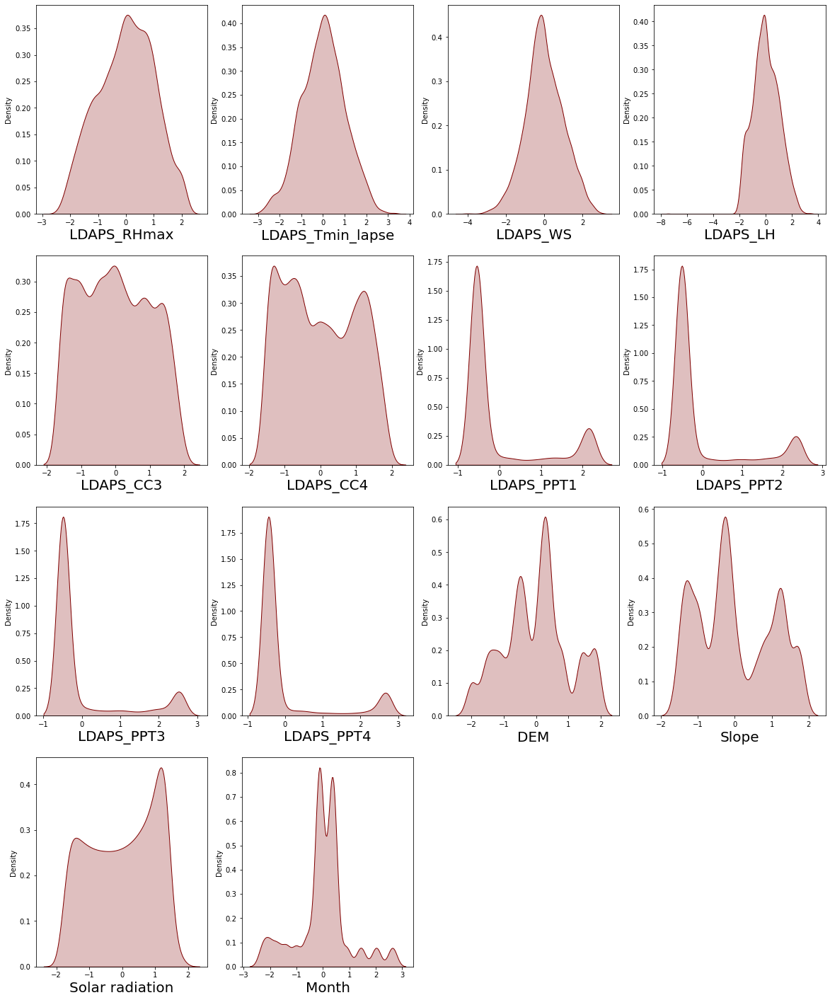

In [131]:
# After removing skewness let's check how the data has been distributed in each column.

plt.figure(figsize=(20,25), facecolor='white')
plotnumber = 1

for column in X[skew]:
    if plotnumber<=14:
        ax = plt.subplot(4,4,plotnumber)
        sns.distplot(X[column],color='maroon',kde_kws={"shade": True},hist=False)
        plt.xlabel(column,fontsize=20)
    plotnumber+=1
plt.show()

After removing the skewness the data looks almost normal compared to old data. The skewness has been removed in all the columns and the skewness is reduced in the columns LDAPS_PPT1, LDAPS_PPT2, LDAPS_PPT3 and LDAPS_PPT4.

Since the precipitation columns have skewness and are not in normal, so we will use MinMaxScaler to scale the data.

## Feature Scaling using MinMaxScaler

In [132]:
from sklearn.preprocessing import MinMaxScaler

mms=MinMaxScaler()
X = pd.DataFrame(mms.fit_transform(X), columns=X.columns)
X

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Day,Month,Year
0,0.500000,0.875000,0.876344,0.192970,0.336495,0.790010,0.581655,0.466086,0.683566,0.004158,0.007783,0.044335,0.196588,0.000000,0.000000,0.000000,0.000000,0.643008,0.831715,0.635190,0.857810,0.224850,0.804651,0.375000,0.537778,0.75
1,0.833333,0.789773,0.838710,0.191006,0.122467,0.811165,0.576788,0.585667,0.531295,0.021785,0.002632,0.227110,0.557767,0.000000,0.000000,0.000000,0.000000,0.500530,0.692557,0.330774,0.372033,0.138409,0.674419,0.625000,0.537778,0.75
2,0.166667,0.284091,0.569892,0.824880,0.772128,0.488643,0.459445,0.714807,0.684210,0.794733,0.628571,0.913639,0.732468,0.959394,0.235370,0.999995,0.000000,0.500530,1.000000,0.443625,0.334076,0.180828,0.530233,0.541667,0.537778,1.00
3,0.750000,0.278409,0.381720,0.228107,0.655910,0.507151,0.279114,0.620925,0.620279,0.249731,0.219543,0.084701,0.083276,0.000000,0.000000,0.000000,0.000000,0.643008,0.362460,0.709380,0.739267,0.109590,0.576744,0.791667,0.537778,0.50
4,0.833333,0.267045,0.655914,0.906027,0.763929,0.392902,0.433414,0.537563,0.602946,0.920424,0.978341,0.962118,0.983223,0.999541,0.999929,0.974155,0.294183,0.500530,0.692557,0.330774,0.372033,0.778346,0.372093,0.000000,1.000000,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,0.208333,0.784091,0.731183,0.266989,0.345944,0.843956,0.698164,0.453828,0.666822,0.294583,0.067750,0.166461,0.139665,0.000000,0.000000,0.000000,0.000000,0.286017,0.699029,0.604369,0.051153,0.455595,0.841860,0.041667,0.110595,0.75
7748,0.291667,0.443182,0.639785,0.444524,0.623351,0.532563,0.272078,0.726109,0.651973,0.286094,0.226345,0.065047,0.011526,0.000000,0.000000,0.000000,0.000000,0.071504,0.271845,0.590723,0.701013,0.864260,0.586047,0.000000,0.050037,0.00
7749,0.000000,0.159091,0.483871,0.535866,0.905669,0.424262,0.289757,0.487342,0.733126,0.677307,0.586162,0.704111,0.318681,0.016752,0.428771,0.903460,0.000000,0.786017,0.533981,1.000000,0.867054,0.513290,0.344186,0.041667,0.344567,0.25
7750,0.291667,0.363636,0.650538,0.679135,0.696486,0.455955,0.519268,0.510268,0.578955,0.589056,0.639190,0.783307,0.512979,0.125896,0.355055,0.000000,0.000000,0.071504,0.271845,0.590723,0.701013,0.721526,0.516279,0.416667,0.437757,0.00


## Checking for Multicolinerity

In [133]:
# Finding variance inflation factor in each scaled column

from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(X.values,i) for i in range(len(X.columns))]
vif["Features"] = X.columns
vif

,VIF values,Features
0,4.598736,station
1,35.154944,Present_Tmax
2,78.080026,Present_Tmin
3,45.986392,LDAPS_RHmin
4,18.751390,LDAPS_RHmax
5,120.720769,LDAPS_Tmax_lapse
6,53.866132,LDAPS_Tmin_lapse
7,20.862029,LDAPS_WS
8,65.951881,LDAPS_LH
9,15.227578,LDAPS_CC1


The column LDAPS_Tmax_lapse has high VIF value compared to other features, we will remove this column to overcome with the issue of multicollinearity. After dropping the column will check VIF again, if we find the value above 10 then we will remove that column having high VIF. This process will continue until we get the VIF value less than 10.

In [134]:
# Dropping LDAPS_Tmax_lapse column
X.drop("LDAPS_Tmax_lapse",axis=1,inplace=True)

In [135]:
# Finding variance inflation factor again

from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(X.values,i) for i in range(len(X.columns))]
vif["Features"] = X.columns
vif

,VIF values,Features
0,4.586394,station
1,34.024946,Present_Tmax
2,76.651387,Present_Tmin
3,33.305067,LDAPS_RHmin
4,18.645062,LDAPS_RHmax
5,35.936726,LDAPS_Tmin_lapse
6,20.603654,LDAPS_WS
7,60.166410,LDAPS_LH
8,15.194305,LDAPS_CC1
9,17.548304,LDAPS_CC2


The column Present_Tmin has high VIF value compared ot other columns. Let's drop this column

In [137]:
# Dropping Present_Tmin column
X.drop("Present_Tmin",axis=1,inplace=True)

In [138]:
# Finding variance inflation factor again

from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(X.values,i) for i in range(len(X.columns))]
vif["Features"] = X.columns
vif

,VIF values,Features
0,4.577625,station
1,30.287860,Present_Tmax
2,33.197151,LDAPS_RHmin
3,18.271453,LDAPS_RHmax
4,29.265115,LDAPS_Tmin_lapse
5,19.912521,LDAPS_WS
6,59.373761,LDAPS_LH
7,14.917525,LDAPS_CC1
8,17.546022,LDAPS_CC2
9,17.732365,LDAPS_CC3


In [139]:
# Dropping the column LDAPS_LH which has high VIF compared to other columns.
X.drop("LDAPS_LH",axis=1,inplace=True)

In [140]:
# Finding variance inflation factor again

from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(X.values,i) for i in range(len(X.columns))]
vif["Features"] = X.columns
vif

,VIF values,Features
0,4.574447,station
1,26.816344,Present_Tmax
2,32.422043,LDAPS_RHmin
3,16.202650,LDAPS_RHmax
4,25.399371,LDAPS_Tmin_lapse
5,18.049204,LDAPS_WS
6,14.507811,LDAPS_CC1
7,17.170673,LDAPS_CC2
8,17.679300,LDAPS_CC3
9,9.675928,LDAPS_CC4


In [141]:
# Dropping Next_Tmax column as it contains high VIF compared to others.
X.drop("Next_Tmax",axis=1,inplace=True)

In [142]:
# Finding variance inflation factor again

from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(X.values,i) for i in range(len(X.columns))]
vif["Features"] = X.columns
vif

,VIF values,Features
0,4.357750,station
1,22.420439,Present_Tmax
2,31.898138,LDAPS_RHmin
3,15.012201,LDAPS_RHmax
4,19.565807,LDAPS_Tmin_lapse
5,17.942441,LDAPS_WS
6,14.506970,LDAPS_CC1
7,16.963098,LDAPS_CC2
8,17.584827,LDAPS_CC3
9,9.659758,LDAPS_CC4


Still the VIF value is above 10 in many columns. Let's drop the column having high VIF value amongst them.

In [143]:
# Dropping LDAPS_RHmin column
X.drop("LDAPS_RHmin",axis=1,inplace=True)

In [144]:
# Finding variance inflation factor again

from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(X.values,i) for i in range(len(X.columns))]
vif["Features"] = X.columns
vif

,VIF values,Features
0,4.353489,station
1,21.959436,Present_Tmax
2,10.499715,LDAPS_RHmax
3,17.943621,LDAPS_Tmin_lapse
4,17.494162,LDAPS_WS
5,14.424490,LDAPS_CC1
6,15.972219,LDAPS_CC2
7,15.747872,LDAPS_CC3
8,9.644795,LDAPS_CC4
9,3.300489,LDAPS_PPT1


In [145]:
# Droppoing Present_Tmax column as it has high VIF values
X.drop("Present_Tmax",axis=1,inplace=True)

In [146]:
# Finding variance inflation factor again

from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(X.values,i) for i in range(len(X.columns))]
vif["Features"] = X.columns
vif

,VIF values,Features
0,4.249027,station
1,10.494177,LDAPS_RHmax
2,8.455902,LDAPS_Tmin_lapse
3,16.864879,LDAPS_WS
4,13.559921,LDAPS_CC1
5,15.963881,LDAPS_CC2
6,15.656609,LDAPS_CC3
7,9.638630,LDAPS_CC4
8,3.270818,LDAPS_PPT1
9,2.956593,LDAPS_PPT2


In [147]:
# Dropping LDAPS_WS column
X.drop("LDAPS_WS",axis=1,inplace=True)

In [148]:
# Finding variance inflation factor again

from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(X.values,i) for i in range(len(X.columns))]
vif["Features"] = X.columns
vif

,VIF values,Features
0,3.968764,station
1,10.436610,LDAPS_RHmax
2,7.862777,LDAPS_Tmin_lapse
3,13.491842,LDAPS_CC1
4,15.963879,LDAPS_CC2
5,15.636447,LDAPS_CC3
6,9.616443,LDAPS_CC4
7,3.269027,LDAPS_PPT1
8,2.955624,LDAPS_PPT2
9,2.200587,LDAPS_PPT3


In [149]:
# Dropping LDAPS_CC2 column as it contains high VIF values compared to others
X.drop("LDAPS_CC2",axis=1,inplace=True)

In [150]:
# Finding variance inflation factor again

from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(X.values,i) for i in range(len(X.columns))]
vif["Features"] = X.columns
vif

,VIF values,Features
0,3.968088,station
1,10.275045,LDAPS_RHmax
2,7.779405,LDAPS_Tmin_lapse
3,9.312590,LDAPS_CC1
4,12.846864,LDAPS_CC3
5,9.616340,LDAPS_CC4
6,3.072742,LDAPS_PPT1
7,2.322113,LDAPS_PPT2
8,2.199760,LDAPS_PPT3
9,2.027317,LDAPS_PPT4


In [151]:
# Removing DEM column
X.drop("DEM",axis=1,inplace=True)

In [152]:
# Finding variance inflation factor again

from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(X.values,i) for i in range(len(X.columns))]
vif["Features"] = X.columns
vif

,VIF values,Features
0,3.680109,station
1,10.128386,LDAPS_RHmax
2,7.716922,LDAPS_Tmin_lapse
3,9.311825,LDAPS_CC1
4,12.843669,LDAPS_CC3
5,9.614301,LDAPS_CC4
6,3.068458,LDAPS_PPT1
7,2.318813,LDAPS_PPT2
8,2.199743,LDAPS_PPT3
9,2.027274,LDAPS_PPT4


In [153]:
# Dropping LDAPS_CC3 column
X.drop("LDAPS_CC3",axis=1,inplace=True)

In [154]:
# Finding variance inflation factor again

from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(X.values,i) for i in range(len(X.columns))]
vif["Features"] = X.columns
vif

,VIF values,Features
0,3.680031,station
1,10.128315,LDAPS_RHmax
2,7.687641,LDAPS_Tmin_lapse
3,8.363750,LDAPS_CC1
4,5.068478,LDAPS_CC4
5,2.973010,LDAPS_PPT1
6,2.303686,LDAPS_PPT2
7,1.977942,LDAPS_PPT3
8,2.015596,LDAPS_PPT4
9,4.878332,lat


In [155]:
# Dropping LDAPS_RHmax column
X.drop("LDAPS_RHmax",axis=1,inplace=True)

In [156]:
# Finding variance inflation factor again

from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["VIF values"] = [variance_inflation_factor(X.values,i) for i in range(len(X.columns))]
vif["Features"] = X.columns
vif

,VIF values,Features
0,3.680020,station
1,7.637569,LDAPS_Tmin_lapse
2,7.980586,LDAPS_CC1
3,5.057435,LDAPS_CC4
4,2.931576,LDAPS_PPT1
5,2.282662,LDAPS_PPT2
6,1.967399,LDAPS_PPT3
7,2.010568,LDAPS_PPT4
8,4.437019,lat
9,5.551137,lon


Finally we are getting the VIF value less than 10 in all the columns which means our data is free from multicollinearity problem.

In [157]:
# Checking dataframe after removing the columns
X.head()

,station,LDAPS_Tmin_lapse,LDAPS_CC1,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,Slope,Solar radiation,Day,Month,Year
0,0.500000,0.581655,0.004158,0.196588,0.000000,0.000000,0.000000,0.000000,0.643008,0.831715,0.857810,0.224850,0.375000,0.537778,0.75
1,0.833333,0.576788,0.021785,0.557767,0.000000,0.000000,0.000000,0.000000,0.500530,0.692557,0.372033,0.138409,0.625000,0.537778,0.75
2,0.166667,0.459445,0.794733,0.732468,0.959394,0.235370,0.999995,0.000000,0.500530,1.000000,0.334076,0.180828,0.541667,0.537778,1.00
3,0.750000,0.279114,0.249731,0.083276,0.000000,0.000000,0.000000,0.000000,0.643008,0.362460,0.739267,0.109590,0.791667,0.537778,0.50
4,0.833333,0.433414,0.920424,0.983223,0.999541,0.999929,0.974155,0.294183,0.500530,0.692557,0.372033,0.778346,0.000000,1.000000,0.00


In [158]:
X.shape

(7752, 15)

After removing the colums containing VIF above 10, the dataframe contains 15 columns. We have done all the preprocessing and data cleaning, now our dataset is ready for building the machine learning models.

# Modeling

### Finding the best random state

In [159]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

In [160]:
from sklearn.ensemble import RandomForestRegressor
maxAccu=0
maxRS=0
for i in range(1,200):
    X_train,X_test,Y_train,Y_test = train_test_split(X,Y,test_size=.30, random_state=i)
    mod = RandomForestRegressor()
    mod.fit(X_train, Y_train)
    pred = mod.predict(X_test)
    acc=r2_score(Y_test, pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print("Maximum r2 score is ",maxAccu," on Random_state ",maxRS)

Maximum r2 score is  0.8985451068891471  on Random_state  57


## Creating new train test split

In [161]:
X_train,X_test,Y_train,Y_test=train_test_split(X,Y,test_size=.30,random_state=maxRS)

## Regression Algorithms

In [162]:
from sklearn.ensemble import RandomForestRegressor,ExtraTreesRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor as KNN
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import BaggingRegressor
import xgboost as xgb
from sklearn.linear_model import SGDRegressor
from sklearn.metrics import classification_report
from sklearn.model_selection import cross_val_score
from sklearn import metrics

## Random Forest Regressor

R2_score: 0.8991527822268935
MAE: 0.6163334096341626
MSE: 0.632855051064226
RSME: 0.7955218734040101


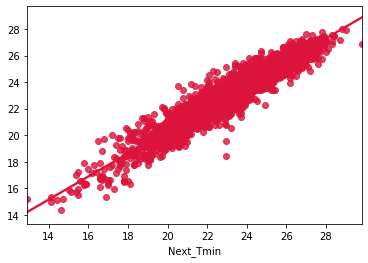

In [163]:
# Checking R2 score for RandomForestRegressor
RFR = RandomForestRegressor()
RFR.fit(X_train,Y_train)
predRFR = RFR.predict(X_test)
print("R2_score:",r2_score(Y_test,predRFR))
print("MAE:",metrics.mean_absolute_error(Y_test,predRFR))
print("MSE:",metrics.mean_squared_error(Y_test,predRFR))
print("RSME:",np.sqrt(metrics.mean_squared_error(Y_test,predRFR)))

# Visualizing the predicted values
sns.regplot(Y_test,predRFR,color="crimson")
plt.show()

The predicted R2 score for Random Forest Regressor is 89.91%.

R2_score: 0.7683129765641332
MAE: 0.9003009458297508
MSE: 1.4539251184629631
RSME: 1.2057881731311528


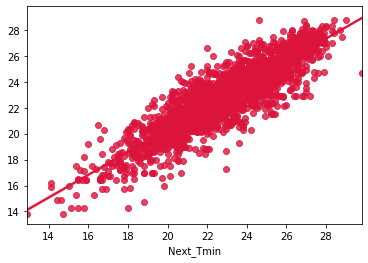

In [164]:
# Checking R2 score for DecisionTreeRegressor
DTR = DecisionTreeRegressor()
DTR.fit(X_train,Y_train)
predDTR = DTR.predict(X_test)
print("R2_score:",r2_score(Y_test,predDTR))
print("MAE:",metrics.mean_absolute_error(Y_test,predDTR))
print("MSE:",metrics.mean_squared_error(Y_test,predDTR))
print("RSME:",np.sqrt(metrics.mean_squared_error(Y_test,predDTR)))

# Visualizing the predicted values
sns.regplot(Y_test,predDTR,color="crimson")
plt.show()

The predicted R2 score for DecisionTreeRegressor is 76.83%.

R2_score: 0.8878930068713764
MAE: 0.6499246132325468
MSE: 0.7035144689930348
RSME: 0.8387576938502769


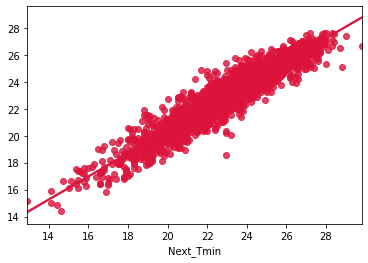

In [166]:
# Checking R2 score for GradientBoostingRegressor
GB = GradientBoostingRegressor()
GB.fit(X_train,Y_train)
predGB = GB.predict(X_test)
print("R2_score:",r2_score(Y_test,predGB))
print("MAE:",metrics.mean_absolute_error(Y_test,predGB))
print("MSE:",metrics.mean_squared_error(Y_test,predGB))
print("RSME:",np.sqrt(metrics.mean_squared_error(Y_test,predGB)))

# Visualizing the predicted values
sns.regplot(Y_test,predGB,color="crimson")
plt.show()

The predicted R2 score for GradientBoostingRegressor is 88.78%.

## KNeighbors Regressor

R2_score: 0.7803704950345234
MAE: 0.9000743284720074
MSE: 1.3782595558843838
RSME: 1.1739929965227152


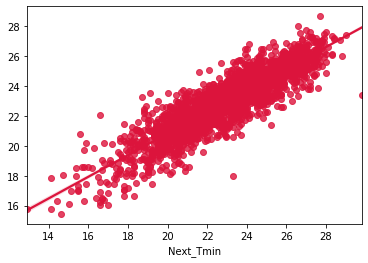

In [167]:
# Checking R2 score for KNeighbors Regressor
knn = KNN()
knn.fit(X_train,Y_train)
predknn = knn.predict(X_test)
print("R2_score:",r2_score(Y_test,predknn))
print("MAE:",metrics.mean_absolute_error(Y_test,predknn))
print("MSE:",metrics.mean_squared_error(Y_test,predknn))
print("RSME:",np.sqrt(metrics.mean_squared_error(Y_test,predknn)))

# Visualizing the predicted values
sns.regplot(Y_test,predknn,color="crimson")
plt.show()

The predicted R2 score for KNeighbors Regressor is 78.03%.

## BaggingRegressor

R2_score: 0.8866358357974742
MAE: 0.6540678787979978
MSE: 0.7114037006618833
RSME: 0.8434475091325383


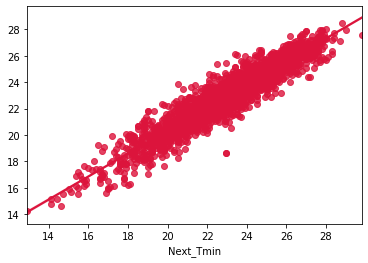

In [168]:
# Checking R2 score for BaggingRegressor
BR = BaggingRegressor()
BR.fit(X_train,Y_train)
predBR = BR.predict(X_test)
print("R2_score:",r2_score(Y_test,predBR))
print("MAE:",metrics.mean_absolute_error(Y_test,predBR))
print("MSE:",metrics.mean_squared_error(Y_test,predBR))
print("RSME:",np.sqrt(metrics.mean_squared_error(Y_test,predBR)))

# Visualizing the predicted values
sns.regplot(Y_test,predBR,color="crimson")
plt.show()

The predicted R2 score for BaggingRegressor is 88.66%.

## XGBRegressor

R2_score: 0.9305910841164503
MAE: 0.4878849614044835
MSE: 0.4355676237357771
RSME: 0.6599754720713317


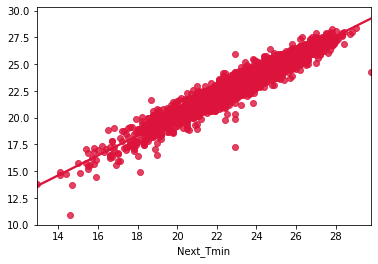

In [170]:
# Checking R2 score for XGBRegressor
from xgboost import XGBRegressor as xgb

XGB=xgb()
XGB.fit(X_train,Y_train)
predXGB = XGB.predict(X_test)
print("R2_score:",r2_score(Y_test,predXGB))
print("MAE:",metrics.mean_absolute_error(Y_test,predXGB))
print("MSE:",metrics.mean_squared_error(Y_test,predXGB))
print("RSME:",np.sqrt(metrics.mean_squared_error(Y_test,predXGB)))

# Visualizing the predicted values
sns.regplot(Y_test,predXGB,color="crimson")
plt.show()

The predicted R2 score for XGBRegressor is 93.05%.

## ExtraTreesRegressor

R2_score: 0.9116241467251327
MAE: 0.5702122517092556
MSE: 0.5545924456036467
RSME: 0.744709638452227


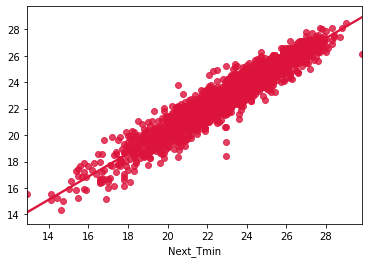

In [171]:
# Checking R2 score for ExtraTreesRegressor
ET = ExtraTreesRegressor()
ET.fit(X_train,Y_train)
predET = ET.predict(X_test)
print("R2_score:",r2_score(Y_test,predET))
print("MAE:",metrics.mean_absolute_error(Y_test,predET))
print("MSE:",metrics.mean_squared_error(Y_test,predET))
print("RSME:",np.sqrt(metrics.mean_squared_error(Y_test,predET)))

# Visualizing the predicted values
sns.regplot(Y_test,predET,color="crimson")
plt.show()

The predicted R2 score for Extra Trees Regressor is 91.16%.

## Checking the cross validation score

In [172]:
from sklearn.model_selection import cross_val_score

In [183]:
# Checking cv score for Random Forest Regressor
score=cross_val_score(RFR,X,Y,cv=5)
print(score)
print("cross validation score:  ",score.mean())
print("Difference between R2 score and cross validation score is - ",r2_score(Y_test,predRFR)-abs(score.mean()))

[0.88712815 0.89085789 0.89880209 0.87899591 0.89794528]
cross validation score:   0.8907458635448033
Difference between R2 score and cross validation score is -  0.008406918682090203


In [184]:
# Checking cv score for Decision Tree Regressor
score=cross_val_score(DTR,X,Y,cv=5)
print(score)
print("cross validation score:  ",score.mean())
print("Difference between R2 score and cross validation score is - ",r2_score(Y_test,predDTR)-abs(score.mean()))

[0.74689836 0.7779916  0.77207275 0.75800505 0.76714583]
cross validation score:   0.7644227180422312
Difference between R2 score and cross validation score is -  0.003890258521902057


In [185]:
# Checking cv score for Gradient Boosting Regressor
score=cross_val_score(GB,X,Y,cv=5)
print(score)
print("cross validation score:  ",score.mean())
print("Difference between R2 score and cross validation score is - ",r2_score(Y_test,predGB)-abs(score.mean()))

[0.87357956 0.87211219 0.88900703 0.86492602 0.88306165]
cross validation score:   0.8765372903075853
Difference between R2 score and cross validation score is -  0.011355716563791085


In [186]:
# Checking cv score for KNeighbors Regressor
score=cross_val_score(knn,X,Y,cv=5)
print(score)
print("cross validation score:  ",score.mean())
print("Difference between R2 score and cross validation score is - ",r2_score(Y_test,predknn)-abs(score.mean()))

[0.80164376 0.77671303 0.7821862  0.78804034 0.78079209]
cross validation score:   0.7858750846469166
Difference between R2 score and cross validation score is -  -0.005504589612393196


In [187]:
# Checking cv score for Bagging Regressor
score=cross_val_score(BR,X,Y,cv=5)
print(score)
print("cross validation score:  ",score.mean())
print("Difference between R2 score and cross validation score is - ",r2_score(Y_test,predBR)-abs(score.mean()))

[0.86966064 0.88064127 0.88328103 0.85722491 0.88654696]
cross validation score:   0.8754709630744374
Difference between R2 score and cross validation score is -  0.01116487272303679


In [188]:
# Checking cv score for XGBRegressor
score=cross_val_score(XGB,X,Y,cv=5)
print(score)
print("cross validation score:  ",score.mean())
print("Difference between R2 score and cross validation score is - ",r2_score(Y_test,predXGB)-abs(score.mean()))

[0.93475073 0.9347316  0.93412976 0.93153307 0.9344937 ]
cross validation score:   0.9339277709752049
Difference between R2 score and cross validation score is -  -0.003336686858754545


In [189]:
# Checking cv score for ExtraTreesRegressor
score=cross_val_score(ET,X,Y,cv=5)
print(score)
print("cross validation score:  ",score.mean())
print("Difference between R2 score and cross validation score is - ",r2_score(Y_test,predET)-abs(score.mean()))

[0.90493868 0.90650356 0.91159065 0.89535338 0.9118813 ]
cross validation score:   0.9060535132626819
Difference between R2 score and cross validation score is -  0.005570633462450791


From the differences between the R2 score and Cross Validation Score we can conclude that XGB Regressor as our best fitting model. We will perform Hyper parameter tuning on the best model.

# Hyper parameter tuning

In [190]:
from sklearn.model_selection import GridSearchCV

In [191]:
#XGB Regressor

parameters = {'n_estimators' : [50,100,200, 400],
              'gamma' : np.arange(0,0.5,0.1),
              'max_depth' : [4, 6, 8,10],
              'n_jobs' : [-2, -1, 1]}

In [192]:
GCV=GridSearchCV(xgb(),parameters,cv=5)

In [193]:
GCV.fit(X_train,Y_train)

GridSearchCV(cv=5,
             estimator=XGBRegressor(base_score=None, booster=None,
                                    colsample_bylevel=None,
                                    colsample_bynode=None,
                                    colsample_bytree=None, gamma=None,
                                    gpu_id=None, importance_type='gain',
                                    interaction_constraints=None,
                                    learning_rate=None, max_delta_step=None,
                                    max_depth=None, min_child_weight=None,
                                    missing=nan, monotone_constraints=None,
                                    n_estimators=100, n_jobs=None,
                                    num_parallel_tree=None, random_state=None,
                                    reg_alpha=None, reg_lambda=None,
                                    scale_pos_weight=None, subsample=None,
                                    tree_method=None, validate_para

In [194]:
GCV.best_params_

{'gamma': 0.0, 'max_depth': 6, 'n_estimators': 400, 'n_jobs': -2}

R2_Score: 93.29097860586893
RMSE value: 0.6488581338630209
MAE: 0.4776416134689832
MSE: 0.42101687788020203


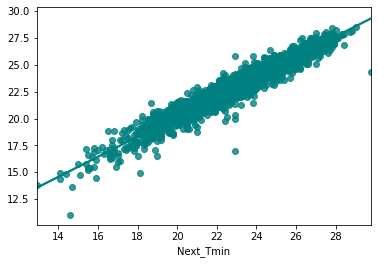

In [195]:
Final_model2 = xgb(gamma=0.0, max_depth=6, n_estimators=400, n_jobs=-2)
Final_model2.fit(X_train, Y_train)
pred = Final_model2.predict(X_test)
print('R2_Score:',r2_score(Y_test,pred)*100)
print("RMSE value:",np.sqrt(metrics.mean_squared_error(Y_test, pred)))
print('MAE:',metrics.mean_absolute_error(Y_test, pred))
print('MSE:',metrics.mean_squared_error(Y_test, pred))

# Visualizing the predicted values
sns.regplot(Y_test,pred,color="teal")
plt.show()

After hyper parameter tuning our best model accuracy increased and is giving 93.29% which is good.

# Saving the model

In [196]:
# Saving the model using .pkl
import joblib
joblib.dump(Final_model2,"Temperature_Forecast_Next_Tmin.pkl")

['Temperature_Forecast_Next_Tmin.pkl']

## Predicting the Saved model

In [197]:
# Loading the saved model
Model = joblib.load("Temperature_Forecast_Next_Tmin.pkl")

# prediction
a = np.array(Y_test)
predicted = np.array(Model.predict(X_test))
df_com = pd.DataFrame({"Original":a,"Predicted":predicted},index= range(len(a)))
df_com

,Original,Predicted
0,25.9,25.874781
1,21.7,21.576591
2,25.8,26.297876
3,23.3,23.639528
4,22.9,22.701641
...,...,...
2321,21.7,21.186834
2322,23.8,23.719769
2323,23.4,23.978445
2324,15.9,16.129831


# Conclusion:

* The final R2 score for the prediction of Next_Tmax using XGBRegressor is 92.29%.
* The final R2 score for the prediction of Next_Tmin using XGBRegressor is 93.29%.